# Example of using The Module Formerly Known as KDE and Asy_peakbag for KIC6442183

This is a notebook showing a rough draft of the replacement module for KDE and Asy_peakbag, which is currently WIP on the PBjam-dev branch.

We'll start by importing the modeID sampler (Should the name be changed?)

In [1]:
%load_ext autoreload
%autoreload 2
from pbjam.modeID import modeIDsampler
from pbjam import IO
import matplotlib.pyplot as plt
import pbjam.distributions as dist
import jax
import jax.numpy as jnp
 
plt.rcParams['font.size'] = 18
jax.config.update('jax_enable_x64', True)

No GPU/TPU found, falling back to CPU. (Set TF_CPP_MIN_LOG_LEVEL=0 and rerun for more info.)


We'll also use the IO module to load the PSD. This is a new module that contains all I/O related matters, saving/loading/downloading etc. The largest part of this is wrapping the various lightkurve steps to getting a PSD. However it now also stores lightkurve search results so that cached data are loaded more quickly. 

The IO.psd class also normalizes the PSD consistently (Parseval). This is important now that we're working on the PSD and not the SNR spectrum.

In [2]:
ID = 'KIC6442183'

psd = IO.psd(ID, lk_kwargs={'exptime': 60, 'mission':'Kepler', 'author':'Kepler'})

psd()

f = psd.freq[::5]

s = psd.powerdensity[::5]

Using cached search result.
Loading fits files from cache.


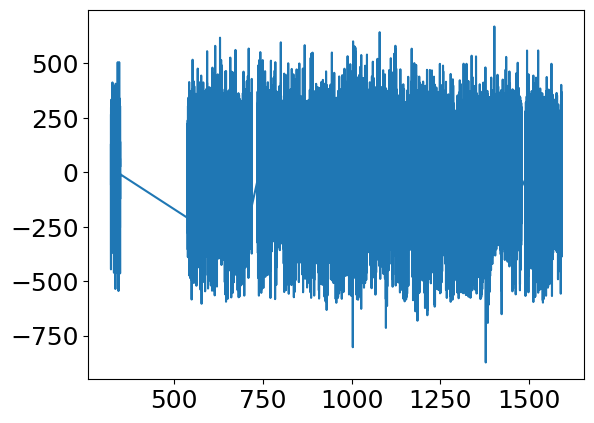

In [3]:
plt.plot(psd._time, psd._flux)

## Priors
With the update to PBjam most of the parameters are included in the dimensionality reduction (DR). The latent parameter priors are constructed by the DR module, using the the prior sample of the model parameters. For the g-mode parameters the prior sample is not even remotely complete however. To get around this we can supply the modeID class with a list of priors for these parameters. They will then automatically be removed from the list of parameters included in the DR.

These priors are all in the form of class instances of distributions, similar to the scipy.stats classes. However, here we're using a set of custom classes that have been jaxed.

In [4]:
addObs = {'numax' : (1125, 20),
          'dnu'  : (64.9, 0.21),
          'teff': (5568.8, 10.0),
          'bp_rp': (0.839183, 0.05), 
          } 

addPriors = {'u1' : dist.beta(a=1.2, b=1.2, loc=-0.1, scale=0.19),
             'u2' : dist.beta(a=1.2, b=1.2, loc=0.001, scale=0.18),
             'DPi1': dist.normal(loc=390, scale=390*0.1),
             'eps_g': dist.beta(loc=0.5, scale=3),
             'd01': dist.normal(loc=24, scale=1),
             'alpha_g': dist.normal(loc=jnp.log10(0.002), scale=0.5),
            }

In [5]:
N_p = 9

N_pca = 20

PCAdims = 6
 
M = modeIDsampler(f, s, addObs, addPriors, N_p=N_p, 
                  Npca=N_pca, PCAdims=PCAdims, priorpath=IO.get_priorpath(), freq_limits = [300, 1500])

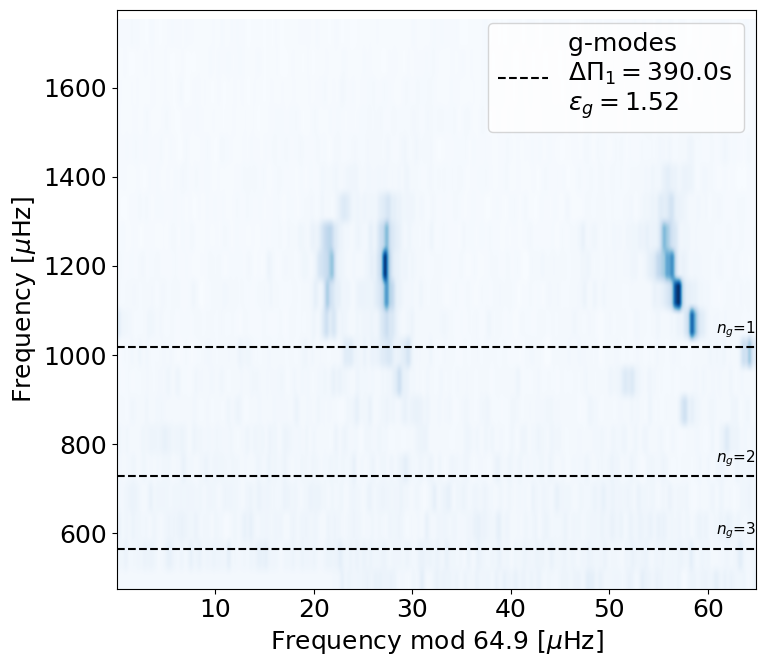

In [6]:
fig, ax = M.echelle(stage='prior', kwargs={'eps_g':1.52});

## Plot the prior
It's always good to check that your prior is reasonable, so lets plot some samples from the prior.

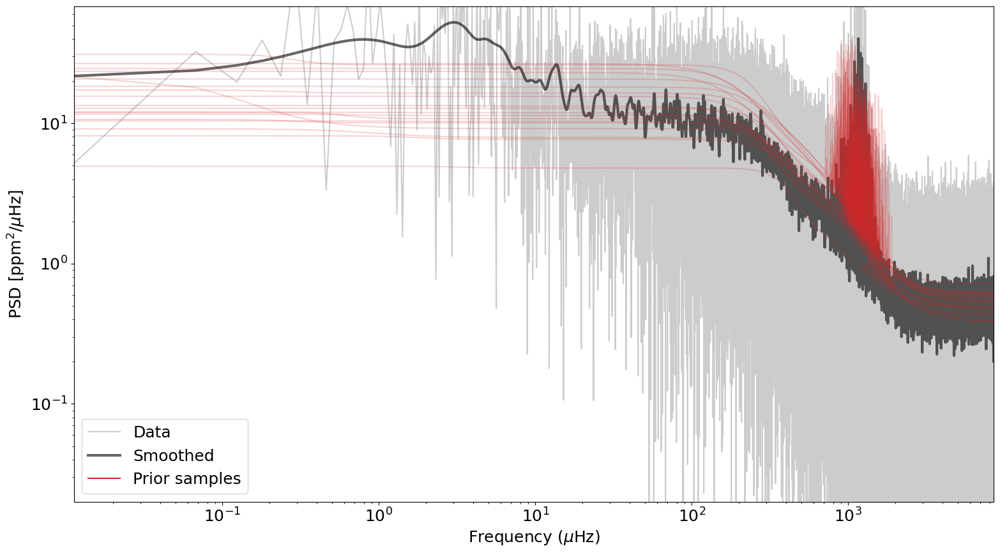

In [7]:
M.spectrum(stage='prior');

## Run Dynesty
Time to run! You can optionally run with the dynamic sampler enabled, but it probably won't do you much good and take an order of magnitude longer.

In [8]:
modeIDsamples, modeIDresult = M(dynesty_kwargs = {'nlive':50*M.ndims})

 ** On entry to DGEBAL parameter number  3 had an illegal value
 ** On entry to DGEHRD parameter number  2 had an illegal value
 ** On entry to DORGHR parameter number  2 had an illegal value
 ** On entry to DHSEQR parameter number  4 had an illegal value
 ** On entry to DGEBAL parameter number  3 had an illegal value
 ** On entry to DGEHRD parameter number  2 had an illegal value
 ** On entry to DORGHR parameter number  2 had an illegal value
 ** On entry to DHSEQR parameter number  4 had an illegal value
 ** On entry to DGEBAL parameter number  3 had an illegal value
 ** On entry to DGEHRD parameter number  2 had an illegal value
 ** On entry to DORGHR parameter number  2 had an illegal value
 ** On entry to DHSEQR parameter number  4 had an illegal value
 ** On entry to DGEBAL parameter number  3 had an illegal value
 ** On entry to DGEHRD parameter number  2 had an illegal value
 ** On entry to DORGHR parameter number  2 had an illegal value
 ** On entry to DHSEQR parameter number 

 ** On entry to DGEBAL parameter number  3 had an illegal value
 ** On entry to DGEHRD parameter number  2 had an illegal value
 ** On entry to DORGHR parameter number  2 had an illegal value
 ** On entry to DHSEQR parameter number  4 had an illegal value
 ** On entry to DGEBAL parameter number  3 had an illegal value
 ** On entry to DGEHRD parameter number  2 had an illegal value
 ** On entry to DORGHR parameter number  2 had an illegal value
 ** On entry to DHSEQR parameter number  4 had an illegal value
 ** On entry to DGEBAL parameter number  3 had an illegal value
 ** On entry to DGEHRD parameter number  2 had an illegal value
 ** On entry to DORGHR parameter number  2 had an illegal value
 ** On entry to DHSEQR parameter number  4 had an illegal value
 ** On entry to DGEBAL parameter number  3 had an illegal value
 ** On entry to DGEHRD parameter number  2 had an illegal value
 ** On entry to DORGHR parameter number  2 had an illegal value
 ** On entry to DHSEQR parameter number 

 ** On entry to DGEBAL parameter number  3 had an illegal value
 ** On entry to DGEHRD parameter number  2 had an illegal value
 ** On entry to DORGHR parameter number  2 had an illegal value
 ** On entry to DHSEQR parameter number  4 had an illegal value
 ** On entry to DGEBAL parameter number  3 had an illegal value
 ** On entry to DGEHRD parameter number  2 had an illegal value
 ** On entry to DORGHR parameter number  2 had an illegal value
 ** On entry to DHSEQR parameter number  4 had an illegal value
 ** On entry to DGEBAL parameter number  3 had an illegal value
 ** On entry to DGEHRD parameter number  2 had an illegal value
 ** On entry to DORGHR parameter number  2 had an illegal value
 ** On entry to DHSEQR parameter number  4 had an illegal value
 ** On entry to DGEBAL parameter number  3 had an illegal value
 ** On entry to DGEHRD parameter number  2 had an illegal value
 ** On entry to DORGHR parameter number  2 had an illegal value
 ** On entry to DHSEQR parameter number 

392it [00:00, 989.57it/s, bound: 0 | nc: 1 | ncall: 2155 | eff(%): 18.190 | loglstar:   -inf < -44558.541 <    inf | logz: -44566.361 +/-  0.065 | dlogz: 4395.788 >  1.709] 

 ** On entry to DGEBAL parameter number  3 had an illegal value
 ** On entry to DGEHRD parameter number  2 had an illegal value
 ** On entry to DORGHR parameter number  2 had an illegal value
 ** On entry to DHSEQR parameter number  4 had an illegal value
 ** On entry to DGEBAL parameter number  3 had an illegal value
 ** On entry to DGEHRD parameter number  2 had an illegal value
 ** On entry to DORGHR parameter number  2 had an illegal value
 ** On entry to DHSEQR parameter number  4 had an illegal value
 ** On entry to DGEBAL parameter number  3 had an illegal value
 ** On entry to DGEHRD parameter number  2 had an illegal value
 ** On entry to DORGHR parameter number  2 had an illegal value
 ** On entry to DHSEQR parameter number  4 had an illegal value
 ** On entry to DGEBAL parameter number  3 had an illegal value
 ** On entry to DGEHRD parameter number  2 had an illegal value
 ** On entry to DORGHR parameter number  2 had an illegal value
 ** On entry to DHSEQR parameter number 

781it [00:00, 907.91it/s, bound: 0 | nc: 1 | ncall: 2706 | eff(%): 28.862 | loglstar:   -inf < -43755.046 <    inf | logz: -43762.500 +/-  0.063 | dlogz: 3591.075 >  1.709]

 ** On entry to DGEBAL parameter number  3 had an illegal value
 ** On entry to DGEHRD parameter number  2 had an illegal value
 ** On entry to DORGHR parameter number  2 had an illegal value
 ** On entry to DHSEQR parameter number  4 had an illegal value
 ** On entry to DGEBAL parameter number  3 had an illegal value
 ** On entry to DGEHRD parameter number  2 had an illegal value
 ** On entry to DORGHR parameter number  2 had an illegal value
 ** On entry to DHSEQR parameter number  4 had an illegal value
 ** On entry to DGEBAL parameter number  3 had an illegal value
 ** On entry to DGEHRD parameter number  2 had an illegal value
 ** On entry to DORGHR parameter number  2 had an illegal value
 ** On entry to DHSEQR parameter number  4 had an illegal value
 ** On entry to DGEBAL parameter number  3 had an illegal value
 ** On entry to DGEHRD parameter number  2 had an illegal value
 ** On entry to DORGHR parameter number  2 had an illegal value
 ** On entry to DHSEQR parameter number 

1273it [00:01, 695.31it/s, bound: 0 | nc: 2 | ncall: 3667 | eff(%): 34.715 | loglstar:   -inf < -43234.603 <    inf | logz: -43242.801 +/-  0.066 | dlogz: 3071.494 >  1.709]

 ** On entry to DGEBAL parameter number  3 had an illegal value
 ** On entry to DGEHRD parameter number  2 had an illegal value
 ** On entry to DORGHR parameter number  2 had an illegal value
 ** On entry to DHSEQR parameter number  4 had an illegal value
 ** On entry to DGEBAL parameter number  3 had an illegal value
 ** On entry to DGEHRD parameter number  2 had an illegal value
 ** On entry to DORGHR parameter number  2 had an illegal value
 ** On entry to DHSEQR parameter number  4 had an illegal value
 ** On entry to DGEBAL parameter number  3 had an illegal value
 ** On entry to DGEHRD parameter number  2 had an illegal value
 ** On entry to DORGHR parameter number  2 had an illegal value
 ** On entry to DHSEQR parameter number  4 had an illegal value
 ** On entry to DGEBAL parameter number  3 had an illegal value
 ** On entry to DGEHRD parameter number  2 had an illegal value
 ** On entry to DORGHR parameter number  2 had an illegal value
 ** On entry to DHSEQR parameter number 

1665it [00:02, 588.84it/s, bound: 0 | nc: 6 | ncall: 4603 | eff(%): 36.172 | loglstar:   -inf < -42963.779 <    inf | logz: -42971.352 +/-  0.064 | dlogz: 2799.159 >  1.709]

 ** On entry to DGEBAL parameter number  3 had an illegal value
 ** On entry to DGEHRD parameter number  2 had an illegal value
 ** On entry to DORGHR parameter number  2 had an illegal value
 ** On entry to DHSEQR parameter number  4 had an illegal value
 ** On entry to DGEBAL parameter number  3 had an illegal value
 ** On entry to DGEHRD parameter number  2 had an illegal value
 ** On entry to DORGHR parameter number  2 had an illegal value
 ** On entry to DHSEQR parameter number  4 had an illegal value
 ** On entry to DGEBAL parameter number  3 had an illegal value
 ** On entry to DGEHRD parameter number  2 had an illegal value
 ** On entry to DORGHR parameter number  2 had an illegal value
 ** On entry to DHSEQR parameter number  4 had an illegal value
 ** On entry to DGEBAL parameter number  3 had an illegal value
 ** On entry to DGEHRD parameter number  2 had an illegal value
 ** On entry to DORGHR parameter number  2 had an illegal value
 ** On entry to DHSEQR parameter number 

1987it [00:02, 481.32it/s, bound: 0 | nc: 2 | ncall: 5591 | eff(%): 35.539 | loglstar:   -inf < -42789.786 <    inf | logz: -42797.441 +/-  0.064 | dlogz: 2625.048 >  1.709]

 ** On entry to DGEBAL parameter number  3 had an illegal value
 ** On entry to DGEHRD parameter number  2 had an illegal value
 ** On entry to DORGHR parameter number  2 had an illegal value
 ** On entry to DHSEQR parameter number  4 had an illegal value
 ** On entry to DGEBAL parameter number  3 had an illegal value
 ** On entry to DGEHRD parameter number  2 had an illegal value
 ** On entry to DORGHR parameter number  2 had an illegal value
 ** On entry to DHSEQR parameter number  4 had an illegal value
 ** On entry to DGEBAL parameter number  3 had an illegal value
 ** On entry to DGEHRD parameter number  2 had an illegal value
 ** On entry to DORGHR parameter number  2 had an illegal value
 ** On entry to DHSEQR parameter number  4 had an illegal value
 ** On entry to DGEBAL parameter number  3 had an illegal value
 ** On entry to DGEHRD parameter number  2 had an illegal value
 ** On entry to DORGHR parameter number  2 had an illegal value
 ** On entry to DHSEQR parameter number 

2266it [00:03, 390.51it/s, bound: 0 | nc: 2 | ncall: 6598 | eff(%): 34.344 | loglstar:   -inf < -42664.246 <    inf | logz: -42672.314 +/-  0.065 | dlogz: 2499.772 >  1.709]

 ** On entry to DGEBAL parameter number  3 had an illegal value
 ** On entry to DGEHRD parameter number  2 had an illegal value
 ** On entry to DORGHR parameter number  2 had an illegal value
 ** On entry to DHSEQR parameter number  4 had an illegal value
 ** On entry to DGEBAL parameter number  3 had an illegal value
 ** On entry to DGEHRD parameter number  2 had an illegal value
 ** On entry to DORGHR parameter number  2 had an illegal value
 ** On entry to DHSEQR parameter number  4 had an illegal value
 ** On entry to DGEBAL parameter number  3 had an illegal value
 ** On entry to DGEHRD parameter number  2 had an illegal value
 ** On entry to DORGHR parameter number  2 had an illegal value
 ** On entry to DHSEQR parameter number  4 had an illegal value
 ** On entry to DGEBAL parameter number  3 had an illegal value
 ** On entry to DGEHRD parameter number  2 had an illegal value
 ** On entry to DORGHR parameter number  2 had an illegal value
 ** On entry to DHSEQR parameter number 

2471it [00:04, 368.11it/s, bound: 0 | nc: 2 | ncall: 7416 | eff(%): 33.320 | loglstar:   -inf < -42587.845 <    inf | logz: -42595.557 +/-  0.065 | dlogz: 2422.754 >  1.709] 

 ** On entry to DGEBAL parameter number  3 had an illegal value
 ** On entry to DGEHRD parameter number  2 had an illegal value
 ** On entry to DORGHR parameter number  2 had an illegal value
 ** On entry to DHSEQR parameter number  4 had an illegal value
 ** On entry to DGEBAL parameter number  3 had an illegal value
 ** On entry to DGEHRD parameter number  2 had an illegal value
 ** On entry to DORGHR parameter number  2 had an illegal value
 ** On entry to DHSEQR parameter number  4 had an illegal value
 ** On entry to DGEBAL parameter number  3 had an illegal value
 ** On entry to DGEHRD parameter number  2 had an illegal value
 ** On entry to DORGHR parameter number  2 had an illegal value
 ** On entry to DHSEQR parameter number  4 had an illegal value
 ** On entry to DGEBAL parameter number  3 had an illegal value
 ** On entry to DGEHRD parameter number  2 had an illegal value
 ** On entry to DORGHR parameter number  2 had an illegal value
 ** On entry to DHSEQR parameter number 

2624it [00:04, 338.29it/s, bound: 0 | nc: 10 | ncall: 8103 | eff(%): 32.383 | loglstar:   -inf < -42534.946 <    inf | logz: -42542.433 +/-  0.063 | dlogz: 2369.399 >  1.709]

 ** On entry to DGEBAL parameter number  3 had an illegal value
 ** On entry to DGEHRD parameter number  2 had an illegal value
 ** On entry to DORGHR parameter number  2 had an illegal value
 ** On entry to DHSEQR parameter number  4 had an illegal value
 ** On entry to DGEBAL parameter number  3 had an illegal value
 ** On entry to DGEHRD parameter number  2 had an illegal value
 ** On entry to DORGHR parameter number  2 had an illegal value
 ** On entry to DHSEQR parameter number  4 had an illegal value
 ** On entry to DGEBAL parameter number  3 had an illegal value
 ** On entry to DGEHRD parameter number  2 had an illegal value
 ** On entry to DORGHR parameter number  2 had an illegal value
 ** On entry to DHSEQR parameter number  4 had an illegal value
 ** On entry to DGEBAL parameter number  3 had an illegal value
 ** On entry to DGEHRD parameter number  2 had an illegal value
 ** On entry to DORGHR parameter number  2 had an illegal value
 ** On entry to DHSEQR parameter number 

2782it [00:05, 278.13it/s, bound: 0 | nc: 10 | ncall: 8989 | eff(%): 30.949 | loglstar:   -inf < -42480.060 <    inf | logz: -42487.960 +/-  0.065 | dlogz: 2314.970 >  1.709]

 ** On entry to DGEBAL parameter number  3 had an illegal value
 ** On entry to DGEHRD parameter number  2 had an illegal value
 ** On entry to DORGHR parameter number  2 had an illegal value
 ** On entry to DHSEQR parameter number  4 had an illegal value
 ** On entry to DGEBAL parameter number  3 had an illegal value
 ** On entry to DGEHRD parameter number  2 had an illegal value
 ** On entry to DORGHR parameter number  2 had an illegal value
 ** On entry to DHSEQR parameter number  4 had an illegal value
 ** On entry to DGEBAL parameter number  3 had an illegal value
 ** On entry to DGEHRD parameter number  2 had an illegal value
 ** On entry to DORGHR parameter number  2 had an illegal value
 ** On entry to DHSEQR parameter number  4 had an illegal value
 ** On entry to DGEBAL parameter number  3 had an illegal value
 ** On entry to DGEHRD parameter number  2 had an illegal value
 ** On entry to DORGHR parameter number  2 had an illegal value
 ** On entry to DHSEQR parameter number 

2873it [00:05, 266.83it/s, bound: 0 | nc: 2 | ncall: 9488 | eff(%): 30.280 | loglstar:   -inf < -42447.384 <    inf | logz: -42455.592 +/-  0.065 | dlogz: 2282.608 >  1.709] 

 ** On entry to DGEBAL parameter number  3 had an illegal value
 ** On entry to DGEHRD parameter number  2 had an illegal value
 ** On entry to DORGHR parameter number  2 had an illegal value
 ** On entry to DHSEQR parameter number  4 had an illegal value
 ** On entry to DGEBAL parameter number  3 had an illegal value
 ** On entry to DGEHRD parameter number  2 had an illegal value
 ** On entry to DORGHR parameter number  2 had an illegal value
 ** On entry to DHSEQR parameter number  4 had an illegal value
 ** On entry to DGEBAL parameter number  3 had an illegal value
 ** On entry to DGEHRD parameter number  2 had an illegal value
 ** On entry to DORGHR parameter number  2 had an illegal value
 ** On entry to DHSEQR parameter number  4 had an illegal value
 ** On entry to DGEBAL parameter number  3 had an illegal value
 ** On entry to DGEHRD parameter number  2 had an illegal value
 ** On entry to DORGHR parameter number  2 had an illegal value
 ** On entry to DHSEQR parameter number 

3039it [00:06, 239.52it/s, bound: 0 | nc: 10 | ncall: 10524 | eff(%): 28.877 | loglstar:   -inf < -42397.772 <    inf | logz: -42405.368 +/-  0.063 | dlogz: 2232.083 >  1.709]

 ** On entry to DGEBAL parameter number  3 had an illegal value
 ** On entry to DGEHRD parameter number  2 had an illegal value
 ** On entry to DORGHR parameter number  2 had an illegal value
 ** On entry to DHSEQR parameter number  4 had an illegal value
 ** On entry to DGEBAL parameter number  3 had an illegal value
 ** On entry to DGEHRD parameter number  2 had an illegal value
 ** On entry to DORGHR parameter number  2 had an illegal value
 ** On entry to DHSEQR parameter number  4 had an illegal value
 ** On entry to DGEBAL parameter number  3 had an illegal value
 ** On entry to DGEHRD parameter number  2 had an illegal value
 ** On entry to DORGHR parameter number  2 had an illegal value
 ** On entry to DHSEQR parameter number  4 had an illegal value
 ** On entry to DGEBAL parameter number  3 had an illegal value
 ** On entry to DGEHRD parameter number  2 had an illegal value
 ** On entry to DORGHR parameter number  2 had an illegal value
 ** On entry to DHSEQR parameter number 

3136it [00:06, 219.17it/s, bound: 0 | nc: 19 | ncall: 11235 | eff(%): 27.913 | loglstar:   -inf < -42373.677 <    inf | logz: -42381.457 +/-  0.064 | dlogz: 2208.144 >  1.709]

 ** On entry to DGEBAL parameter number  3 had an illegal value
 ** On entry to DGEHRD parameter number  2 had an illegal value
 ** On entry to DORGHR parameter number  2 had an illegal value
 ** On entry to DHSEQR parameter number  4 had an illegal value
 ** On entry to DGEBAL parameter number  3 had an illegal value
 ** On entry to DGEHRD parameter number  2 had an illegal value
 ** On entry to DORGHR parameter number  2 had an illegal value
 ** On entry to DHSEQR parameter number  4 had an illegal value
 ** On entry to DGEBAL parameter number  3 had an illegal value
 ** On entry to DGEHRD parameter number  2 had an illegal value
 ** On entry to DORGHR parameter number  2 had an illegal value
 ** On entry to DHSEQR parameter number  4 had an illegal value
 ** On entry to DGEBAL parameter number  3 had an illegal value
 ** On entry to DGEHRD parameter number  2 had an illegal value
 ** On entry to DORGHR parameter number  2 had an illegal value
 ** On entry to DHSEQR parameter number 

3186it [00:06, 219.81it/s, bound: 0 | nc: 9 | ncall: 11590 | eff(%): 27.489 | loglstar:   -inf < -42362.433 <    inf | logz: -42369.929 +/-  0.062 | dlogz: 2196.505 >  1.709] 

 ** On entry to DGEBAL parameter number  3 had an illegal value
 ** On entry to DGEHRD parameter number  2 had an illegal value
 ** On entry to DORGHR parameter number  2 had an illegal value
 ** On entry to DHSEQR parameter number  4 had an illegal value
 ** On entry to DGEBAL parameter number  3 had an illegal value
 ** On entry to DGEHRD parameter number  2 had an illegal value
 ** On entry to DORGHR parameter number  2 had an illegal value
 ** On entry to DHSEQR parameter number  4 had an illegal value
 ** On entry to DGEBAL parameter number  3 had an illegal value
 ** On entry to DGEHRD parameter number  2 had an illegal value
 ** On entry to DORGHR parameter number  2 had an illegal value
 ** On entry to DHSEQR parameter number  4 had an illegal value
 ** On entry to DGEBAL parameter number  3 had an illegal value
 ** On entry to DGEHRD parameter number  2 had an illegal value
 ** On entry to DORGHR parameter number  2 had an illegal value
 ** On entry to DHSEQR parameter number 

3333it [00:07, 220.99it/s, bound: 0 | nc: 1 | ncall: 12622 | eff(%): 26.406 | loglstar:   -inf < -42326.016 <    inf | logz: -42334.835 +/-  0.066 | dlogz: 2161.624 >  1.709]

 ** On entry to DGEBAL parameter number  3 had an illegal value
 ** On entry to DGEHRD parameter number  2 had an illegal value
 ** On entry to DORGHR parameter number  2 had an illegal value
 ** On entry to DHSEQR parameter number  4 had an illegal value
 ** On entry to DGEBAL parameter number  3 had an illegal value
 ** On entry to DGEHRD parameter number  2 had an illegal value
 ** On entry to DORGHR parameter number  2 had an illegal value
 ** On entry to DHSEQR parameter number  4 had an illegal value
 ** On entry to DGEBAL parameter number  3 had an illegal value
 ** On entry to DGEHRD parameter number  2 had an illegal value
 ** On entry to DORGHR parameter number  2 had an illegal value
 ** On entry to DHSEQR parameter number  4 had an illegal value
 ** On entry to DGEBAL parameter number  3 had an illegal value
 ** On entry to DGEHRD parameter number  2 had an illegal value
 ** On entry to DORGHR parameter number  2 had an illegal value
 ** On entry to DHSEQR parameter number 

3477it [00:08, 219.70it/s, bound: 0 | nc: 8 | ncall: 13654 | eff(%): 25.465 | loglstar:   -inf < -42291.753 <    inf | logz: -42299.884 +/-  0.064 | dlogz: 2126.393 >  1.709] 

 ** On entry to DGEBAL parameter number  3 had an illegal value
 ** On entry to DGEHRD parameter number  2 had an illegal value
 ** On entry to DORGHR parameter number  2 had an illegal value
 ** On entry to DHSEQR parameter number  4 had an illegal value
 ** On entry to DGEBAL parameter number  3 had an illegal value
 ** On entry to DGEHRD parameter number  2 had an illegal value
 ** On entry to DORGHR parameter number  2 had an illegal value
 ** On entry to DHSEQR parameter number  4 had an illegal value
 ** On entry to DGEBAL parameter number  3 had an illegal value
 ** On entry to DGEHRD parameter number  2 had an illegal value
 ** On entry to DORGHR parameter number  2 had an illegal value
 ** On entry to DHSEQR parameter number  4 had an illegal value
 ** On entry to DGEBAL parameter number  3 had an illegal value
 ** On entry to DGEHRD parameter number  2 had an illegal value
 ** On entry to DORGHR parameter number  2 had an illegal value
 ** On entry to DHSEQR parameter number 

3589it [00:08, 168.78it/s, bound: 0 | nc: 9 | ncall: 14508 | eff(%): 24.738 | loglstar:   -inf < -42267.002 <    inf | logz: -42274.596 +/-  0.063 | dlogz: 2100.919 >  1.709] 

 ** On entry to DGEBAL parameter number  3 had an illegal value
 ** On entry to DGEHRD parameter number  2 had an illegal value
 ** On entry to DORGHR parameter number  2 had an illegal value
 ** On entry to DHSEQR parameter number  4 had an illegal value
 ** On entry to DGEBAL parameter number  3 had an illegal value
 ** On entry to DGEHRD parameter number  2 had an illegal value
 ** On entry to DORGHR parameter number  2 had an illegal value
 ** On entry to DHSEQR parameter number  4 had an illegal value
 ** On entry to DGEBAL parameter number  3 had an illegal value
 ** On entry to DGEHRD parameter number  2 had an illegal value
 ** On entry to DORGHR parameter number  2 had an illegal value
 ** On entry to DHSEQR parameter number  4 had an illegal value
 ** On entry to DGEBAL parameter number  3 had an illegal value
 ** On entry to DGEHRD parameter number  2 had an illegal value
 ** On entry to DORGHR parameter number  2 had an illegal value
 ** On entry to DHSEQR parameter number 

3647it [00:09, 180.23it/s, bound: 0 | nc: 19 | ncall: 14965 | eff(%): 24.370 | loglstar:   -inf < -42249.924 <    inf | logz: -42257.720 +/-  0.065 | dlogz: 2084.048 >  1.709]

 ** On entry to DGEBAL parameter number  3 had an illegal value
 ** On entry to DGEHRD parameter number  2 had an illegal value
 ** On entry to DORGHR parameter number  2 had an illegal value
 ** On entry to DHSEQR parameter number  4 had an illegal value
 ** On entry to DGEBAL parameter number  3 had an illegal value
 ** On entry to DGEHRD parameter number  2 had an illegal value
 ** On entry to DORGHR parameter number  2 had an illegal value
 ** On entry to DHSEQR parameter number  4 had an illegal value
 ** On entry to DGEBAL parameter number  3 had an illegal value
 ** On entry to DGEHRD parameter number  2 had an illegal value
 ** On entry to DORGHR parameter number  2 had an illegal value
 ** On entry to DHSEQR parameter number  4 had an illegal value
 ** On entry to DGEBAL parameter number  3 had an illegal value
 ** On entry to DGEHRD parameter number  2 had an illegal value
 ** On entry to DORGHR parameter number  2 had an illegal value
 ** On entry to DHSEQR parameter number 

3725it [00:09, 168.53it/s, bound: 0 | nc: 18 | ncall: 15728 | eff(%): 23.684 | loglstar:   -inf < -42231.938 <    inf | logz: -42240.136 +/-  0.066 | dlogz: 2066.509 >  1.709]

 ** On entry to DGEBAL parameter number  3 had an illegal value
 ** On entry to DGEHRD parameter number  2 had an illegal value
 ** On entry to DORGHR parameter number  2 had an illegal value
 ** On entry to DHSEQR parameter number  4 had an illegal value
 ** On entry to DGEBAL parameter number  3 had an illegal value
 ** On entry to DGEHRD parameter number  2 had an illegal value
 ** On entry to DORGHR parameter number  2 had an illegal value
 ** On entry to DHSEQR parameter number  4 had an illegal value
 ** On entry to DGEBAL parameter number  3 had an illegal value
 ** On entry to DGEHRD parameter number  2 had an illegal value
 ** On entry to DORGHR parameter number  2 had an illegal value
 ** On entry to DHSEQR parameter number  4 had an illegal value
 ** On entry to DGEBAL parameter number  3 had an illegal value
 ** On entry to DGEHRD parameter number  2 had an illegal value
 ** On entry to DORGHR parameter number  2 had an illegal value
 ** On entry to DHSEQR parameter number 

3802it [00:10, 174.30it/s, bound: 0 | nc: 11 | ncall: 16414 | eff(%): 23.163 | loglstar:   -inf < -42214.672 <    inf | logz: -42222.575 +/-  0.065 | dlogz: 2048.819 >  1.709]

 ** On entry to DGEBAL parameter number  3 had an illegal value
 ** On entry to DGEHRD parameter number  2 had an illegal value
 ** On entry to DORGHR parameter number  2 had an illegal value
 ** On entry to DHSEQR parameter number  4 had an illegal value
 ** On entry to DGEBAL parameter number  3 had an illegal value
 ** On entry to DGEHRD parameter number  2 had an illegal value
 ** On entry to DORGHR parameter number  2 had an illegal value
 ** On entry to DHSEQR parameter number  4 had an illegal value
 ** On entry to DGEBAL parameter number  3 had an illegal value
 ** On entry to DGEHRD parameter number  2 had an illegal value
 ** On entry to DORGHR parameter number  2 had an illegal value
 ** On entry to DHSEQR parameter number  4 had an illegal value
 ** On entry to DGEBAL parameter number  3 had an illegal value
 ** On entry to DGEHRD parameter number  2 had an illegal value
 ** On entry to DORGHR parameter number  2 had an illegal value
 ** On entry to DHSEQR parameter number 

3894it [00:10, 151.33it/s, bound: 0 | nc: 4 | ncall: 17286 | eff(%): 22.527 | loglstar:   -inf < -42191.742 <    inf | logz: -42199.471 +/-  0.065 | dlogz: 2025.618 >  1.709] 

 ** On entry to DGEBAL parameter number  3 had an illegal value
 ** On entry to DGEHRD parameter number  2 had an illegal value
 ** On entry to DORGHR parameter number  2 had an illegal value
 ** On entry to DHSEQR parameter number  4 had an illegal value
 ** On entry to DGEBAL parameter number  3 had an illegal value
 ** On entry to DGEHRD parameter number  2 had an illegal value
 ** On entry to DORGHR parameter number  2 had an illegal value
 ** On entry to DHSEQR parameter number  4 had an illegal value
 ** On entry to DGEBAL parameter number  3 had an illegal value
 ** On entry to DGEHRD parameter number  2 had an illegal value
 ** On entry to DORGHR parameter number  2 had an illegal value
 ** On entry to DHSEQR parameter number  4 had an illegal value
 ** On entry to DGEBAL parameter number  3 had an illegal value
 ** On entry to DGEHRD parameter number  2 had an illegal value
 ** On entry to DORGHR parameter number  2 had an illegal value
 ** On entry to DHSEQR parameter number 

3959it [00:11, 188.70it/s, bound: 0 | nc: 18 | ncall: 17765 | eff(%): 22.285 | loglstar:   -inf < -42178.630 <    inf | logz: -42187.036 +/-  0.065 | dlogz: 2013.223 >  1.709]

 ** On entry to DGEBAL parameter number  3 had an illegal value
 ** On entry to DGEHRD parameter number  2 had an illegal value
 ** On entry to DORGHR parameter number  2 had an illegal value
 ** On entry to DHSEQR parameter number  4 had an illegal value
 ** On entry to DGEBAL parameter number  3 had an illegal value
 ** On entry to DGEHRD parameter number  2 had an illegal value
 ** On entry to DORGHR parameter number  2 had an illegal value
 ** On entry to DHSEQR parameter number  4 had an illegal value
 ** On entry to DGEBAL parameter number  3 had an illegal value
 ** On entry to DGEHRD parameter number  2 had an illegal value
 ** On entry to DORGHR parameter number  2 had an illegal value
 ** On entry to DHSEQR parameter number  4 had an illegal value
 ** On entry to DGEBAL parameter number  3 had an illegal value
 ** On entry to DGEHRD parameter number  2 had an illegal value
 ** On entry to DORGHR parameter number  2 had an illegal value
 ** On entry to DHSEQR parameter number 

4031it [00:11, 142.32it/s, bound: 0 | nc: 58 | ncall: 18615 | eff(%): 21.655 | loglstar:   -inf < -42164.526 <    inf | logz: -42173.073 +/-  0.065 | dlogz: 1999.321 >  1.709]

 ** On entry to DGEBAL parameter number  3 had an illegal value
 ** On entry to DGEHRD parameter number  2 had an illegal value
 ** On entry to DORGHR parameter number  2 had an illegal value
 ** On entry to DHSEQR parameter number  4 had an illegal value
 ** On entry to DGEBAL parameter number  3 had an illegal value
 ** On entry to DGEHRD parameter number  2 had an illegal value
 ** On entry to DORGHR parameter number  2 had an illegal value
 ** On entry to DHSEQR parameter number  4 had an illegal value
 ** On entry to DGEBAL parameter number  3 had an illegal value
 ** On entry to DGEHRD parameter number  2 had an illegal value
 ** On entry to DORGHR parameter number  2 had an illegal value
 ** On entry to DHSEQR parameter number  4 had an illegal value
 ** On entry to DGEBAL parameter number  3 had an illegal value
 ** On entry to DGEHRD parameter number  2 had an illegal value
 ** On entry to DORGHR parameter number  2 had an illegal value
 ** On entry to DHSEQR parameter number 

4092it [00:12, 135.89it/s, bound: 0 | nc: 10 | ncall: 19298 | eff(%): 21.204 | loglstar:   -inf < -42154.251 <    inf | logz: -42161.891 +/-  0.063 | dlogz: 1987.894 >  1.709]

 ** On entry to DGEBAL parameter number  3 had an illegal value
 ** On entry to DGEHRD parameter number  2 had an illegal value
 ** On entry to DORGHR parameter number  2 had an illegal value
 ** On entry to DHSEQR parameter number  4 had an illegal value
 ** On entry to DGEBAL parameter number  3 had an illegal value
 ** On entry to DGEHRD parameter number  2 had an illegal value
 ** On entry to DORGHR parameter number  2 had an illegal value
 ** On entry to DHSEQR parameter number  4 had an illegal value
 ** On entry to DGEBAL parameter number  3 had an illegal value
 ** On entry to DGEHRD parameter number  2 had an illegal value
 ** On entry to DORGHR parameter number  2 had an illegal value
 ** On entry to DHSEQR parameter number  4 had an illegal value
 ** On entry to DGEBAL parameter number  3 had an illegal value
 ** On entry to DGEHRD parameter number  2 had an illegal value
 ** On entry to DORGHR parameter number  2 had an illegal value
 ** On entry to DHSEQR parameter number 

4153it [00:12, 141.66it/s, bound: 0 | nc: 7 | ncall: 19999 | eff(%): 20.766 | loglstar:   -inf < -42143.229 <    inf | logz: -42151.069 +/-  0.064 | dlogz: 1977.054 >  1.709] 

 ** On entry to DGEBAL parameter number  3 had an illegal value
 ** On entry to DGEHRD parameter number  2 had an illegal value
 ** On entry to DORGHR parameter number  2 had an illegal value
 ** On entry to DHSEQR parameter number  4 had an illegal value
 ** On entry to DGEBAL parameter number  3 had an illegal value
 ** On entry to DGEHRD parameter number  2 had an illegal value
 ** On entry to DORGHR parameter number  2 had an illegal value
 ** On entry to DHSEQR parameter number  4 had an illegal value
 ** On entry to DGEBAL parameter number  3 had an illegal value
 ** On entry to DGEHRD parameter number  2 had an illegal value
 ** On entry to DORGHR parameter number  2 had an illegal value
 ** On entry to DHSEQR parameter number  4 had an illegal value
 ** On entry to DGEBAL parameter number  3 had an illegal value
 ** On entry to DGEHRD parameter number  2 had an illegal value
 ** On entry to DORGHR parameter number  2 had an illegal value
 ** On entry to DHSEQR parameter number 

4222it [00:13, 137.30it/s, bound: 0 | nc: 46 | ncall: 20739 | eff(%): 20.358 | loglstar:   -inf < -42130.808 <    inf | logz: -42138.799 +/-  0.064 | dlogz: 1964.768 >  1.709]

 ** On entry to DGEBAL parameter number  3 had an illegal value
 ** On entry to DGEHRD parameter number  2 had an illegal value
 ** On entry to DORGHR parameter number  2 had an illegal value
 ** On entry to DHSEQR parameter number  4 had an illegal value
 ** On entry to DGEBAL parameter number  3 had an illegal value
 ** On entry to DGEHRD parameter number  2 had an illegal value
 ** On entry to DORGHR parameter number  2 had an illegal value
 ** On entry to DHSEQR parameter number  4 had an illegal value
 ** On entry to DGEBAL parameter number  3 had an illegal value
 ** On entry to DGEHRD parameter number  2 had an illegal value
 ** On entry to DORGHR parameter number  2 had an illegal value
 ** On entry to DHSEQR parameter number  4 had an illegal value
 ** On entry to DGEBAL parameter number  3 had an illegal value
 ** On entry to DGEHRD parameter number  2 had an illegal value
 ** On entry to DORGHR parameter number  2 had an illegal value
 ** On entry to DHSEQR parameter number 

4265it [00:13, 121.50it/s, bound: 0 | nc: 17 | ncall: 21311 | eff(%): 20.013 | loglstar:   -inf < -42122.189 <    inf | logz: -42130.593 +/-  0.066 | dlogz: 1956.598 >  1.709]

 ** On entry to DGEBAL parameter number  3 had an illegal value
 ** On entry to DGEHRD parameter number  2 had an illegal value
 ** On entry to DORGHR parameter number  2 had an illegal value
 ** On entry to DHSEQR parameter number  4 had an illegal value
 ** On entry to DGEBAL parameter number  3 had an illegal value
 ** On entry to DGEHRD parameter number  2 had an illegal value
 ** On entry to DORGHR parameter number  2 had an illegal value
 ** On entry to DHSEQR parameter number  4 had an illegal value
 ** On entry to DGEBAL parameter number  3 had an illegal value
 ** On entry to DGEHRD parameter number  2 had an illegal value
 ** On entry to DORGHR parameter number  2 had an illegal value
 ** On entry to DHSEQR parameter number  4 had an illegal value
 ** On entry to DGEBAL parameter number  3 had an illegal value
 ** On entry to DGEHRD parameter number  2 had an illegal value
 ** On entry to DORGHR parameter number  2 had an illegal value
 ** On entry to DHSEQR parameter number 

4323it [00:13, 114.41it/s, bound: 0 | nc: 6 | ncall: 22174 | eff(%): 19.496 | loglstar:   -inf < -42111.819 <    inf | logz: -42120.342 +/-  0.066 | dlogz: 1946.305 >  1.709] 

 ** On entry to DGEBAL parameter number  3 had an illegal value
 ** On entry to DGEHRD parameter number  2 had an illegal value
 ** On entry to DORGHR parameter number  2 had an illegal value
 ** On entry to DHSEQR parameter number  4 had an illegal value
 ** On entry to DGEBAL parameter number  3 had an illegal value
 ** On entry to DGEHRD parameter number  2 had an illegal value
 ** On entry to DORGHR parameter number  2 had an illegal value
 ** On entry to DHSEQR parameter number  4 had an illegal value
 ** On entry to DGEBAL parameter number  3 had an illegal value
 ** On entry to DGEHRD parameter number  2 had an illegal value
 ** On entry to DORGHR parameter number  2 had an illegal value
 ** On entry to DHSEQR parameter number  4 had an illegal value
 ** On entry to DGEBAL parameter number  3 had an illegal value
 ** On entry to DGEHRD parameter number  2 had an illegal value
 ** On entry to DORGHR parameter number  2 had an illegal value
 ** On entry to DHSEQR parameter number 

4383it [00:14, 112.51it/s, bound: 0 | nc: 27 | ncall: 23054 | eff(%): 19.012 | loglstar:   -inf < -42101.689 <    inf | logz: -42110.384 +/-  0.064 | dlogz: 1936.301 >  1.709]

 ** On entry to DGEBAL parameter number  3 had an illegal value
 ** On entry to DGEHRD parameter number  2 had an illegal value
 ** On entry to DORGHR parameter number  2 had an illegal value
 ** On entry to DHSEQR parameter number  4 had an illegal value
 ** On entry to DGEBAL parameter number  3 had an illegal value
 ** On entry to DGEHRD parameter number  2 had an illegal value
 ** On entry to DORGHR parameter number  2 had an illegal value
 ** On entry to DHSEQR parameter number  4 had an illegal value
 ** On entry to DGEBAL parameter number  3 had an illegal value
 ** On entry to DGEHRD parameter number  2 had an illegal value
 ** On entry to DORGHR parameter number  2 had an illegal value
 ** On entry to DHSEQR parameter number  4 had an illegal value
 ** On entry to DGEBAL parameter number  3 had an illegal value
 ** On entry to DGEHRD parameter number  2 had an illegal value
 ** On entry to DORGHR parameter number  2 had an illegal value
 ** On entry to DHSEQR parameter number 

4407it [00:14, 112.12it/s, bound: 0 | nc: 43 | ncall: 23387 | eff(%): 18.844 | loglstar:   -inf < -42097.163 <    inf | logz: -42105.404 +/-  0.066 | dlogz: 1931.289 >  1.709]

 ** On entry to DGEBAL parameter number  3 had an illegal value
 ** On entry to DGEHRD parameter number  2 had an illegal value
 ** On entry to DORGHR parameter number  2 had an illegal value
 ** On entry to DHSEQR parameter number  4 had an illegal value
 ** On entry to DGEBAL parameter number  3 had an illegal value
 ** On entry to DGEHRD parameter number  2 had an illegal value
 ** On entry to DORGHR parameter number  2 had an illegal value
 ** On entry to DHSEQR parameter number  4 had an illegal value
 ** On entry to DGEBAL parameter number  3 had an illegal value
 ** On entry to DGEHRD parameter number  2 had an illegal value
 ** On entry to DORGHR parameter number  2 had an illegal value
 ** On entry to DHSEQR parameter number  4 had an illegal value
 ** On entry to DGEBAL parameter number  3 had an illegal value
 ** On entry to DGEHRD parameter number  2 had an illegal value
 ** On entry to DORGHR parameter number  2 had an illegal value
 ** On entry to DHSEQR parameter number 

4468it [00:15, 108.45it/s, bound: 0 | nc: 17 | ncall: 24276 | eff(%): 18.405 | loglstar:   -inf < -42085.789 <    inf | logz: -42094.028 +/-  0.066 | dlogz: 1919.863 >  1.709]

 ** On entry to DGEBAL parameter number  3 had an illegal value
 ** On entry to DGEHRD parameter number  2 had an illegal value
 ** On entry to DORGHR parameter number  2 had an illegal value
 ** On entry to DHSEQR parameter number  4 had an illegal value
 ** On entry to DGEBAL parameter number  3 had an illegal value
 ** On entry to DGEHRD parameter number  2 had an illegal value
 ** On entry to DORGHR parameter number  2 had an illegal value
 ** On entry to DHSEQR parameter number  4 had an illegal value
 ** On entry to DGEBAL parameter number  3 had an illegal value
 ** On entry to DGEHRD parameter number  2 had an illegal value
 ** On entry to DORGHR parameter number  2 had an illegal value
 ** On entry to DHSEQR parameter number  4 had an illegal value
 ** On entry to DGEBAL parameter number  3 had an illegal value
 ** On entry to DGEHRD parameter number  2 had an illegal value
 ** On entry to DORGHR parameter number  2 had an illegal value
 ** On entry to DHSEQR parameter number 

4531it [00:15, 104.04it/s, bound: 0 | nc: 1 | ncall: 25208 | eff(%): 17.974 | loglstar:   -inf < -42073.914 <    inf | logz: -42082.281 +/-  0.066 | dlogz: 1908.084 >  1.709] 

 ** On entry to DGEBAL parameter number  3 had an illegal value
 ** On entry to DGEHRD parameter number  2 had an illegal value
 ** On entry to DORGHR parameter number  2 had an illegal value
 ** On entry to DHSEQR parameter number  4 had an illegal value
 ** On entry to DGEBAL parameter number  3 had an illegal value
 ** On entry to DGEHRD parameter number  2 had an illegal value
 ** On entry to DORGHR parameter number  2 had an illegal value
 ** On entry to DHSEQR parameter number  4 had an illegal value
 ** On entry to DGEBAL parameter number  3 had an illegal value
 ** On entry to DGEHRD parameter number  2 had an illegal value
 ** On entry to DORGHR parameter number  2 had an illegal value
 ** On entry to DHSEQR parameter number  4 had an illegal value
 ** On entry to DGEBAL parameter number  3 had an illegal value
 ** On entry to DGEHRD parameter number  2 had an illegal value
 ** On entry to DORGHR parameter number  2 had an illegal value
 ** On entry to DHSEQR parameter number 

4589it [00:16, 89.08it/s, bound: 0 | nc: 93 | ncall: 26132 | eff(%): 17.561 | loglstar:   -inf < -42062.971 <    inf | logz: -42071.393 +/-  0.065 | dlogz: 1897.182 >  1.709] 

 ** On entry to DGEBAL parameter number  3 had an illegal value
 ** On entry to DGEHRD parameter number  2 had an illegal value
 ** On entry to DORGHR parameter number  2 had an illegal value
 ** On entry to DHSEQR parameter number  4 had an illegal value
 ** On entry to DGEBAL parameter number  3 had an illegal value
 ** On entry to DGEHRD parameter number  2 had an illegal value
 ** On entry to DORGHR parameter number  2 had an illegal value
 ** On entry to DHSEQR parameter number  4 had an illegal value
 ** On entry to DGEBAL parameter number  3 had an illegal value
 ** On entry to DGEHRD parameter number  2 had an illegal value
 ** On entry to DORGHR parameter number  2 had an illegal value
 ** On entry to DHSEQR parameter number  4 had an illegal value
 ** On entry to DGEBAL parameter number  3 had an illegal value
 ** On entry to DGEHRD parameter number  2 had an illegal value
 ** On entry to DORGHR parameter number  2 had an illegal value
 ** On entry to DHSEQR parameter number 

4690it [00:17, 127.85it/s, bound: 0 | nc: 13 | ncall: 27320 | eff(%): 17.167 | loglstar:   -inf < -42044.989 <    inf | logz: -42053.303 +/-  0.066 | dlogz: 1878.990 >  1.709]

 ** On entry to DGEBAL parameter number  3 had an illegal value
 ** On entry to DGEHRD parameter number  2 had an illegal value
 ** On entry to DORGHR parameter number  2 had an illegal value
 ** On entry to DHSEQR parameter number  4 had an illegal value
 ** On entry to DGEBAL parameter number  3 had an illegal value
 ** On entry to DGEHRD parameter number  2 had an illegal value
 ** On entry to DORGHR parameter number  2 had an illegal value
 ** On entry to DHSEQR parameter number  4 had an illegal value
 ** On entry to DGEBAL parameter number  3 had an illegal value
 ** On entry to DGEHRD parameter number  2 had an illegal value
 ** On entry to DORGHR parameter number  2 had an illegal value
 ** On entry to DHSEQR parameter number  4 had an illegal value
 ** On entry to DGEBAL parameter number  3 had an illegal value
 ** On entry to DGEHRD parameter number  2 had an illegal value
 ** On entry to DORGHR parameter number  2 had an illegal value
 ** On entry to DHSEQR parameter number 

4731it [00:17, 103.46it/s, bound: 0 | nc: 18 | ncall: 27991 | eff(%): 16.902 | loglstar:   -inf < -42036.146 <    inf | logz: -42044.764 +/-  0.067 | dlogz: 1870.457 >  1.709]

 ** On entry to DGEBAL parameter number  3 had an illegal value
 ** On entry to DGEHRD parameter number  2 had an illegal value
 ** On entry to DORGHR parameter number  2 had an illegal value
 ** On entry to DHSEQR parameter number  4 had an illegal value
 ** On entry to DGEBAL parameter number  3 had an illegal value
 ** On entry to DGEHRD parameter number  2 had an illegal value
 ** On entry to DORGHR parameter number  2 had an illegal value
 ** On entry to DHSEQR parameter number  4 had an illegal value
 ** On entry to DGEBAL parameter number  3 had an illegal value
 ** On entry to DGEHRD parameter number  2 had an illegal value
 ** On entry to DORGHR parameter number  2 had an illegal value
 ** On entry to DHSEQR parameter number  4 had an illegal value
 ** On entry to DGEBAL parameter number  3 had an illegal value
 ** On entry to DGEHRD parameter number  2 had an illegal value
 ** On entry to DORGHR parameter number  2 had an illegal value
 ** On entry to DHSEQR parameter number 

4755it [00:18, 97.61it/s, bound: 0 | nc: 75 | ncall: 28379 | eff(%): 16.755 | loglstar:   -inf < -42032.497 <    inf | logz: -42040.566 +/-  0.066 | dlogz: 1866.182 >  1.709] 

 ** On entry to DGEBAL parameter number  3 had an illegal value
 ** On entry to DGEHRD parameter number  2 had an illegal value
 ** On entry to DORGHR parameter number  2 had an illegal value
 ** On entry to DHSEQR parameter number  4 had an illegal value
 ** On entry to DGEBAL parameter number  3 had an illegal value
 ** On entry to DGEHRD parameter number  2 had an illegal value
 ** On entry to DORGHR parameter number  2 had an illegal value
 ** On entry to DHSEQR parameter number  4 had an illegal value
 ** On entry to DGEBAL parameter number  3 had an illegal value
 ** On entry to DGEHRD parameter number  2 had an illegal value
 ** On entry to DORGHR parameter number  2 had an illegal value
 ** On entry to DHSEQR parameter number  4 had an illegal value
 ** On entry to DGEBAL parameter number  3 had an illegal value
 ** On entry to DGEHRD parameter number  2 had an illegal value
 ** On entry to DORGHR parameter number  2 had an illegal value
 ** On entry to DHSEQR parameter number 

4799it [00:18, 70.10it/s, bound: 0 | nc: 64 | ncall: 29313 | eff(%): 16.372 | loglstar:   -inf < -42025.734 <    inf | logz: -42034.686 +/-  0.067 | dlogz: 1860.387 >  1.709] 

 ** On entry to DGEBAL parameter number  3 had an illegal value
 ** On entry to DGEHRD parameter number  2 had an illegal value
 ** On entry to DORGHR parameter number  2 had an illegal value
 ** On entry to DHSEQR parameter number  4 had an illegal value
 ** On entry to DGEBAL parameter number  3 had an illegal value
 ** On entry to DGEHRD parameter number  2 had an illegal value
 ** On entry to DORGHR parameter number  2 had an illegal value
 ** On entry to DHSEQR parameter number  4 had an illegal value
 ** On entry to DGEBAL parameter number  3 had an illegal value
 ** On entry to DGEHRD parameter number  2 had an illegal value
 ** On entry to DORGHR parameter number  2 had an illegal value
 ** On entry to DHSEQR parameter number  4 had an illegal value
 ** On entry to DGEBAL parameter number  3 had an illegal value
 ** On entry to DGEHRD parameter number  2 had an illegal value
 ** On entry to DORGHR parameter number  2 had an illegal value
 ** On entry to DHSEQR parameter number 

4857it [00:19, 87.56it/s, bound: 0 | nc: 4 | ncall: 30272 | eff(%): 16.045 | loglstar:   -inf < -42017.934 <    inf | logz: -42025.736 +/-  0.065 | dlogz: 1851.261 >  1.709] 

 ** On entry to DGEBAL parameter number  3 had an illegal value
 ** On entry to DGEHRD parameter number  2 had an illegal value
 ** On entry to DORGHR parameter number  2 had an illegal value
 ** On entry to DHSEQR parameter number  4 had an illegal value
 ** On entry to DGEBAL parameter number  3 had an illegal value
 ** On entry to DGEHRD parameter number  2 had an illegal value
 ** On entry to DORGHR parameter number  2 had an illegal value
 ** On entry to DHSEQR parameter number  4 had an illegal value
 ** On entry to DGEBAL parameter number  3 had an illegal value
 ** On entry to DGEHRD parameter number  2 had an illegal value
 ** On entry to DORGHR parameter number  2 had an illegal value
 ** On entry to DHSEQR parameter number  4 had an illegal value
 ** On entry to DGEBAL parameter number  3 had an illegal value
 ** On entry to DGEHRD parameter number  2 had an illegal value
 ** On entry to DORGHR parameter number  2 had an illegal value
 ** On entry to DHSEQR parameter number 

4884it [00:19, 79.03it/s, bound: 0 | nc: 1 | ncall: 30875 | eff(%): 15.819 | loglstar:   -inf < -42013.666 <    inf | logz: -42022.254 +/-  0.066 | dlogz: 1847.844 >  1.709] 

 ** On entry to DGEBAL parameter number  3 had an illegal value
 ** On entry to DGEHRD parameter number  2 had an illegal value
 ** On entry to DORGHR parameter number  2 had an illegal value
 ** On entry to DHSEQR parameter number  4 had an illegal value
 ** On entry to DGEBAL parameter number  3 had an illegal value
 ** On entry to DGEHRD parameter number  2 had an illegal value
 ** On entry to DORGHR parameter number  2 had an illegal value
 ** On entry to DHSEQR parameter number  4 had an illegal value
 ** On entry to DGEBAL parameter number  3 had an illegal value
 ** On entry to DGEHRD parameter number  2 had an illegal value
 ** On entry to DORGHR parameter number  2 had an illegal value
 ** On entry to DHSEQR parameter number  4 had an illegal value
 ** On entry to DGEBAL parameter number  3 had an illegal value
 ** On entry to DGEHRD parameter number  2 had an illegal value
 ** On entry to DORGHR parameter number  2 had an illegal value
 ** On entry to DHSEQR parameter number 

4932it [00:20, 79.33it/s, bound: 0 | nc: 37 | ncall: 31833 | eff(%): 15.493 | loglstar:   -inf < -42003.568 <    inf | logz: -42012.562 +/-  0.068 | dlogz: 1838.191 >  1.709]

 ** On entry to DGEBAL parameter number  3 had an illegal value
 ** On entry to DGEHRD parameter number  2 had an illegal value
 ** On entry to DORGHR parameter number  2 had an illegal value
 ** On entry to DHSEQR parameter number  4 had an illegal value
 ** On entry to DGEBAL parameter number  3 had an illegal value
 ** On entry to DGEHRD parameter number  2 had an illegal value
 ** On entry to DORGHR parameter number  2 had an illegal value
 ** On entry to DHSEQR parameter number  4 had an illegal value
 ** On entry to DGEBAL parameter number  3 had an illegal value
 ** On entry to DGEHRD parameter number  2 had an illegal value
 ** On entry to DORGHR parameter number  2 had an illegal value
 ** On entry to DHSEQR parameter number  4 had an illegal value
 ** On entry to DGEBAL parameter number  3 had an illegal value
 ** On entry to DGEHRD parameter number  2 had an illegal value
 ** On entry to DORGHR parameter number  2 had an illegal value
 ** On entry to DHSEQR parameter number 

4971it [00:20, 77.91it/s, bound: 0 | nc: 51 | ncall: 32642 | eff(%): 15.229 | loglstar:   -inf < -41996.174 <    inf | logz: -42004.731 +/-  0.067 | dlogz: 1830.265 >  1.709]

 ** On entry to DGEBAL parameter number  3 had an illegal value
 ** On entry to DGEHRD parameter number  2 had an illegal value
 ** On entry to DORGHR parameter number  2 had an illegal value
 ** On entry to DHSEQR parameter number  4 had an illegal value
 ** On entry to DGEBAL parameter number  3 had an illegal value
 ** On entry to DGEHRD parameter number  2 had an illegal value
 ** On entry to DORGHR parameter number  2 had an illegal value
 ** On entry to DHSEQR parameter number  4 had an illegal value
 ** On entry to DGEBAL parameter number  3 had an illegal value
 ** On entry to DGEHRD parameter number  2 had an illegal value
 ** On entry to DORGHR parameter number  2 had an illegal value
 ** On entry to DHSEQR parameter number  4 had an illegal value
 ** On entry to DGEBAL parameter number  3 had an illegal value
 ** On entry to DGEHRD parameter number  2 had an illegal value
 ** On entry to DORGHR parameter number  2 had an illegal value
 ** On entry to DHSEQR parameter number 

5012it [00:21, 84.98it/s, bound: 0 | nc: 60 | ncall: 33376 | eff(%): 15.017 | loglstar:   -inf < -41986.194 <    inf | logz: -41995.515 +/-  0.070 | dlogz: 1821.276 >  1.709] 

 ** On entry to DGEBAL parameter number  3 had an illegal value
 ** On entry to DGEHRD parameter number  2 had an illegal value
 ** On entry to DORGHR parameter number  2 had an illegal value
 ** On entry to DHSEQR parameter number  4 had an illegal value
 ** On entry to DGEBAL parameter number  3 had an illegal value
 ** On entry to DGEHRD parameter number  2 had an illegal value
 ** On entry to DORGHR parameter number  2 had an illegal value
 ** On entry to DHSEQR parameter number  4 had an illegal value
 ** On entry to DGEBAL parameter number  3 had an illegal value
 ** On entry to DGEHRD parameter number  2 had an illegal value
 ** On entry to DORGHR parameter number  2 had an illegal value
 ** On entry to DHSEQR parameter number  4 had an illegal value
 ** On entry to DGEBAL parameter number  3 had an illegal value
 ** On entry to DGEHRD parameter number  2 had an illegal value
 ** On entry to DORGHR parameter number  2 had an illegal value
 ** On entry to DHSEQR parameter number 

5044it [00:21, 96.03it/s, bound: 0 | nc: 25 | ncall: 33849 | eff(%): 14.901 | loglstar:   -inf < -41980.353 <    inf | logz: -41988.743 +/-  0.067 | dlogz: 1814.207 >  1.709]

 ** On entry to DGEBAL parameter number  3 had an illegal value
 ** On entry to DGEHRD parameter number  2 had an illegal value
 ** On entry to DORGHR parameter number  2 had an illegal value
 ** On entry to DHSEQR parameter number  4 had an illegal value
 ** On entry to DGEBAL parameter number  3 had an illegal value
 ** On entry to DGEHRD parameter number  2 had an illegal value
 ** On entry to DORGHR parameter number  2 had an illegal value
 ** On entry to DHSEQR parameter number  4 had an illegal value
 ** On entry to DGEBAL parameter number  3 had an illegal value
 ** On entry to DGEHRD parameter number  2 had an illegal value
 ** On entry to DORGHR parameter number  2 had an illegal value
 ** On entry to DHSEQR parameter number  4 had an illegal value
 ** On entry to DGEBAL parameter number  3 had an illegal value
 ** On entry to DGEHRD parameter number  2 had an illegal value
 ** On entry to DORGHR parameter number  2 had an illegal value
 ** On entry to DHSEQR parameter number 

5094it [00:22, 68.62it/s, bound: 0 | nc: 17 | ncall: 34984 | eff(%): 14.561 | loglstar:   -inf < -41972.173 <    inf | logz: -41980.986 +/-  0.067 | dlogz: 2262.579 >  1.709]

 ** On entry to DGEBAL parameter number  3 had an illegal value
 ** On entry to DGEHRD parameter number  2 had an illegal value
 ** On entry to DORGHR parameter number  2 had an illegal value
 ** On entry to DHSEQR parameter number  4 had an illegal value
 ** On entry to DGEBAL parameter number  3 had an illegal value
 ** On entry to DGEHRD parameter number  2 had an illegal value
 ** On entry to DORGHR parameter number  2 had an illegal value
 ** On entry to DHSEQR parameter number  4 had an illegal value
 ** On entry to DGEBAL parameter number  3 had an illegal value
 ** On entry to DGEHRD parameter number  2 had an illegal value
 ** On entry to DORGHR parameter number  2 had an illegal value
 ** On entry to DHSEQR parameter number  4 had an illegal value
 ** On entry to DGEBAL parameter number  3 had an illegal value
 ** On entry to DGEHRD parameter number  2 had an illegal value
 ** On entry to DORGHR parameter number  2 had an illegal value
 ** On entry to DHSEQR parameter number 

5128it [00:22, 56.90it/s, bound: 0 | nc: 21 | ncall: 35897 | eff(%): 14.285 | loglstar:   -inf < -41964.808 <    inf | logz: -41973.549 +/-  0.068 | dlogz: 2255.115 >  1.709]

 ** On entry to DGEBAL parameter number  3 had an illegal value
 ** On entry to DGEHRD parameter number  2 had an illegal value
 ** On entry to DORGHR parameter number  2 had an illegal value
 ** On entry to DHSEQR parameter number  4 had an illegal value
 ** On entry to DGEBAL parameter number  3 had an illegal value
 ** On entry to DGEHRD parameter number  2 had an illegal value
 ** On entry to DORGHR parameter number  2 had an illegal value
 ** On entry to DHSEQR parameter number  4 had an illegal value
 ** On entry to DGEBAL parameter number  3 had an illegal value
 ** On entry to DGEHRD parameter number  2 had an illegal value
 ** On entry to DORGHR parameter number  2 had an illegal value
 ** On entry to DHSEQR parameter number  4 had an illegal value
 ** On entry to DGEBAL parameter number  3 had an illegal value
 ** On entry to DGEHRD parameter number  2 had an illegal value
 ** On entry to DORGHR parameter number  2 had an illegal value
 ** On entry to DHSEQR parameter number 

5168it [00:23, 82.13it/s, bound: 0 | nc: 15 | ncall: 36554 | eff(%): 14.138 | loglstar:   -inf < -41958.197 <    inf | logz: -41966.685 +/-  0.067 | dlogz: 2248.177 >  1.709]

 ** On entry to DGEBAL parameter number  3 had an illegal value
 ** On entry to DGEHRD parameter number  2 had an illegal value
 ** On entry to DORGHR parameter number  2 had an illegal value
 ** On entry to DHSEQR parameter number  4 had an illegal value
 ** On entry to DGEBAL parameter number  3 had an illegal value
 ** On entry to DGEHRD parameter number  2 had an illegal value
 ** On entry to DORGHR parameter number  2 had an illegal value
 ** On entry to DHSEQR parameter number  4 had an illegal value
 ** On entry to DGEBAL parameter number  3 had an illegal value
 ** On entry to DGEHRD parameter number  2 had an illegal value
 ** On entry to DORGHR parameter number  2 had an illegal value
 ** On entry to DHSEQR parameter number  4 had an illegal value
 ** On entry to DGEBAL parameter number  3 had an illegal value
 ** On entry to DGEHRD parameter number  2 had an illegal value
 ** On entry to DORGHR parameter number  2 had an illegal value
 ** On entry to DHSEQR parameter number 

5234it [00:24, 70.99it/s, bound: 0 | nc: 4 | ncall: 37881 | eff(%): 13.817 | loglstar:   -inf < -41945.530 <    inf | logz: -41954.072 +/-  0.067 | dlogz: 2235.537 >  1.709] 

 ** On entry to DGEBAL parameter number  3 had an illegal value
 ** On entry to DGEHRD parameter number  2 had an illegal value
 ** On entry to DORGHR parameter number  2 had an illegal value
 ** On entry to DHSEQR parameter number  4 had an illegal value
 ** On entry to DGEBAL parameter number  3 had an illegal value
 ** On entry to DGEHRD parameter number  2 had an illegal value
 ** On entry to DORGHR parameter number  2 had an illegal value
 ** On entry to DHSEQR parameter number  4 had an illegal value
 ** On entry to DGEBAL parameter number  3 had an illegal value
 ** On entry to DGEHRD parameter number  2 had an illegal value
 ** On entry to DORGHR parameter number  2 had an illegal value
 ** On entry to DHSEQR parameter number  4 had an illegal value
 ** On entry to DGEBAL parameter number  3 had an illegal value
 ** On entry to DGEHRD parameter number  2 had an illegal value
 ** On entry to DORGHR parameter number  2 had an illegal value
 ** On entry to DHSEQR parameter number 

5273it [00:24, 67.04it/s, bound: 0 | nc: 31 | ncall: 38719 | eff(%): 13.619 | loglstar:   -inf < -41939.592 <    inf | logz: -41948.389 +/-  0.068 | dlogz: 2229.869 >  1.709]

 ** On entry to DGEBAL parameter number  3 had an illegal value
 ** On entry to DGEHRD parameter number  2 had an illegal value
 ** On entry to DORGHR parameter number  2 had an illegal value
 ** On entry to DHSEQR parameter number  4 had an illegal value
 ** On entry to DGEBAL parameter number  3 had an illegal value
 ** On entry to DGEHRD parameter number  2 had an illegal value
 ** On entry to DORGHR parameter number  2 had an illegal value
 ** On entry to DHSEQR parameter number  4 had an illegal value
 ** On entry to DGEBAL parameter number  3 had an illegal value
 ** On entry to DGEHRD parameter number  2 had an illegal value
 ** On entry to DORGHR parameter number  2 had an illegal value
 ** On entry to DHSEQR parameter number  4 had an illegal value
 ** On entry to DGEBAL parameter number  3 had an illegal value
 ** On entry to DGEHRD parameter number  2 had an illegal value
 ** On entry to DORGHR parameter number  2 had an illegal value
 ** On entry to DHSEQR parameter number 

5319it [00:25, 55.52it/s, bound: 0 | nc: 79 | ncall: 39947 | eff(%): 13.315 | loglstar:   -inf < -41931.892 <    inf | logz: -41940.974 +/-  0.069 | dlogz: 2222.492 >  1.709]

 ** On entry to DGEBAL parameter number  3 had an illegal value
 ** On entry to DGEHRD parameter number  2 had an illegal value
 ** On entry to DORGHR parameter number  2 had an illegal value
 ** On entry to DHSEQR parameter number  4 had an illegal value
 ** On entry to DGEBAL parameter number  3 had an illegal value
 ** On entry to DGEHRD parameter number  2 had an illegal value
 ** On entry to DORGHR parameter number  2 had an illegal value
 ** On entry to DHSEQR parameter number  4 had an illegal value
 ** On entry to DGEBAL parameter number  3 had an illegal value
 ** On entry to DGEHRD parameter number  2 had an illegal value
 ** On entry to DORGHR parameter number  2 had an illegal value
 ** On entry to DHSEQR parameter number  4 had an illegal value
 ** On entry to DGEBAL parameter number  3 had an illegal value
 ** On entry to DGEHRD parameter number  2 had an illegal value
 ** On entry to DORGHR parameter number  2 had an illegal value
 ** On entry to DHSEQR parameter number 

5339it [00:25, 43.98it/s, bound: 0 | nc: 19 | ncall: 40721 | eff(%): 13.111 | loglstar:   -inf < -41926.015 <    inf | logz: -41935.444 +/-  0.071 | dlogz: 2217.038 >  1.709]

 ** On entry to DGEBAL parameter number  3 had an illegal value
 ** On entry to DGEHRD parameter number  2 had an illegal value
 ** On entry to DORGHR parameter number  2 had an illegal value
 ** On entry to DHSEQR parameter number  4 had an illegal value
 ** On entry to DGEBAL parameter number  3 had an illegal value
 ** On entry to DGEHRD parameter number  2 had an illegal value
 ** On entry to DORGHR parameter number  2 had an illegal value
 ** On entry to DHSEQR parameter number  4 had an illegal value
 ** On entry to DGEBAL parameter number  3 had an illegal value
 ** On entry to DGEHRD parameter number  2 had an illegal value
 ** On entry to DORGHR parameter number  2 had an illegal value
 ** On entry to DHSEQR parameter number  4 had an illegal value
 ** On entry to DGEBAL parameter number  3 had an illegal value
 ** On entry to DGEHRD parameter number  2 had an illegal value
 ** On entry to DORGHR parameter number  2 had an illegal value
 ** On entry to DHSEQR parameter number 

5384it [00:26, 69.86it/s, bound: 0 | nc: 45 | ncall: 41580 | eff(%): 12.949 | loglstar:   -inf < -41918.007 <    inf | logz: -41926.880 +/-  0.068 | dlogz: 2208.293 >  1.709]

 ** On entry to DGEBAL parameter number  3 had an illegal value
 ** On entry to DGEHRD parameter number  2 had an illegal value
 ** On entry to DORGHR parameter number  2 had an illegal value
 ** On entry to DHSEQR parameter number  4 had an illegal value
 ** On entry to DGEBAL parameter number  3 had an illegal value
 ** On entry to DGEHRD parameter number  2 had an illegal value
 ** On entry to DORGHR parameter number  2 had an illegal value
 ** On entry to DHSEQR parameter number  4 had an illegal value
 ** On entry to DGEBAL parameter number  3 had an illegal value
 ** On entry to DGEHRD parameter number  2 had an illegal value
 ** On entry to DORGHR parameter number  2 had an illegal value
 ** On entry to DHSEQR parameter number  4 had an illegal value
 ** On entry to DGEBAL parameter number  3 had an illegal value
 ** On entry to DGEHRD parameter number  2 had an illegal value
 ** On entry to DORGHR parameter number  2 had an illegal value
 ** On entry to DHSEQR parameter number 

5429it [00:27, 84.54it/s, bound: 0 | nc: 28 | ncall: 42413 | eff(%): 12.800 | loglstar:   -inf < -41909.422 <    inf | logz: -41918.469 +/-  0.069 | dlogz: 2199.893 >  1.709]

 ** On entry to DGEBAL parameter number  3 had an illegal value
 ** On entry to DGEHRD parameter number  2 had an illegal value
 ** On entry to DORGHR parameter number  2 had an illegal value
 ** On entry to DHSEQR parameter number  4 had an illegal value
 ** On entry to DGEBAL parameter number  3 had an illegal value
 ** On entry to DGEHRD parameter number  2 had an illegal value
 ** On entry to DORGHR parameter number  2 had an illegal value
 ** On entry to DHSEQR parameter number  4 had an illegal value
 ** On entry to DGEBAL parameter number  3 had an illegal value
 ** On entry to DGEHRD parameter number  2 had an illegal value
 ** On entry to DORGHR parameter number  2 had an illegal value
 ** On entry to DHSEQR parameter number  4 had an illegal value
 ** On entry to DGEBAL parameter number  3 had an illegal value
 ** On entry to DGEHRD parameter number  2 had an illegal value
 ** On entry to DORGHR parameter number  2 had an illegal value
 ** On entry to DHSEQR parameter number 

5479it [00:27, 75.19it/s, bound: 0 | nc: 17 | ncall: 43439 | eff(%): 12.613 | loglstar:   -inf < -41897.724 <    inf | logz: -41906.393 +/-  0.069 | dlogz: 2187.711 >  1.709]

 ** On entry to DGEBAL parameter number  3 had an illegal value
 ** On entry to DGEHRD parameter number  2 had an illegal value
 ** On entry to DORGHR parameter number  2 had an illegal value
 ** On entry to DHSEQR parameter number  4 had an illegal value
 ** On entry to DGEBAL parameter number  3 had an illegal value
 ** On entry to DGEHRD parameter number  2 had an illegal value
 ** On entry to DORGHR parameter number  2 had an illegal value
 ** On entry to DHSEQR parameter number  4 had an illegal value
 ** On entry to DGEBAL parameter number  3 had an illegal value
 ** On entry to DGEHRD parameter number  2 had an illegal value
 ** On entry to DORGHR parameter number  2 had an illegal value
 ** On entry to DHSEQR parameter number  4 had an illegal value
 ** On entry to DGEBAL parameter number  3 had an illegal value
 ** On entry to DGEHRD parameter number  2 had an illegal value
 ** On entry to DORGHR parameter number  2 had an illegal value
 ** On entry to DHSEQR parameter number 

5520it [00:28, 62.65it/s, bound: 0 | nc: 107 | ncall: 44400 | eff(%): 12.432 | loglstar:   -inf < -41887.792 <    inf | logz: -41896.893 +/-  0.071 | dlogz: 2178.270 >  1.709]

 ** On entry to DGEBAL parameter number  3 had an illegal value
 ** On entry to DGEHRD parameter number  2 had an illegal value
 ** On entry to DORGHR parameter number  2 had an illegal value
 ** On entry to DHSEQR parameter number  4 had an illegal value
 ** On entry to DGEBAL parameter number  3 had an illegal value
 ** On entry to DGEHRD parameter number  2 had an illegal value
 ** On entry to DORGHR parameter number  2 had an illegal value
 ** On entry to DHSEQR parameter number  4 had an illegal value
 ** On entry to DGEBAL parameter number  3 had an illegal value
 ** On entry to DGEHRD parameter number  2 had an illegal value
 ** On entry to DORGHR parameter number  2 had an illegal value
 ** On entry to DHSEQR parameter number  4 had an illegal value
 ** On entry to DGEBAL parameter number  3 had an illegal value
 ** On entry to DGEHRD parameter number  2 had an illegal value
 ** On entry to DORGHR parameter number  2 had an illegal value
 ** On entry to DHSEQR parameter number 

5589it [00:29, 72.21it/s, bound: 0 | nc: 101 | ncall: 45980 | eff(%): 12.155 | loglstar:   -inf < -41875.842 <    inf | logz: -41884.491 +/-  0.068 | dlogz: 2165.729 >  1.709]

 ** On entry to DGEBAL parameter number  3 had an illegal value
 ** On entry to DGEHRD parameter number  2 had an illegal value
 ** On entry to DORGHR parameter number  2 had an illegal value
 ** On entry to DHSEQR parameter number  4 had an illegal value
 ** On entry to DGEBAL parameter number  3 had an illegal value
 ** On entry to DGEHRD parameter number  2 had an illegal value
 ** On entry to DORGHR parameter number  2 had an illegal value
 ** On entry to DHSEQR parameter number  4 had an illegal value
 ** On entry to DGEBAL parameter number  3 had an illegal value
 ** On entry to DGEHRD parameter number  2 had an illegal value
 ** On entry to DORGHR parameter number  2 had an illegal value
 ** On entry to DHSEQR parameter number  4 had an illegal value
 ** On entry to DGEBAL parameter number  3 had an illegal value
 ** On entry to DGEHRD parameter number  2 had an illegal value
 ** On entry to DORGHR parameter number  2 had an illegal value
 ** On entry to DHSEQR parameter number 

5645it [00:30, 70.20it/s, bound: 0 | nc: 11 | ncall: 47280 | eff(%): 11.940 | loglstar:   -inf < -41866.973 <    inf | logz: -41875.743 +/-  0.068 | dlogz: 2156.964 >  1.709] 

 ** On entry to DGEBAL parameter number  3 had an illegal value
 ** On entry to DGEHRD parameter number  2 had an illegal value
 ** On entry to DORGHR parameter number  2 had an illegal value
 ** On entry to DHSEQR parameter number  4 had an illegal value
 ** On entry to DGEBAL parameter number  3 had an illegal value
 ** On entry to DGEHRD parameter number  2 had an illegal value
 ** On entry to DORGHR parameter number  2 had an illegal value
 ** On entry to DHSEQR parameter number  4 had an illegal value
 ** On entry to DGEBAL parameter number  3 had an illegal value
 ** On entry to DGEHRD parameter number  2 had an illegal value
 ** On entry to DORGHR parameter number  2 had an illegal value
 ** On entry to DHSEQR parameter number  4 had an illegal value
 ** On entry to DGEBAL parameter number  3 had an illegal value
 ** On entry to DGEHRD parameter number  2 had an illegal value
 ** On entry to DORGHR parameter number  2 had an illegal value
 ** On entry to DHSEQR parameter number 

5675it [00:30, 60.13it/s, bound: 0 | nc: 65 | ncall: 48116 | eff(%): 11.794 | loglstar:   -inf < -41863.182 <    inf | logz: -41871.903 +/-  0.067 | dlogz: 2153.088 >  1.709]

 ** On entry to DGEBAL parameter number  3 had an illegal value
 ** On entry to DGEHRD parameter number  2 had an illegal value
 ** On entry to DORGHR parameter number  2 had an illegal value
 ** On entry to DHSEQR parameter number  4 had an illegal value
 ** On entry to DGEBAL parameter number  3 had an illegal value
 ** On entry to DGEHRD parameter number  2 had an illegal value
 ** On entry to DORGHR parameter number  2 had an illegal value
 ** On entry to DHSEQR parameter number  4 had an illegal value
 ** On entry to DGEBAL parameter number  3 had an illegal value
 ** On entry to DGEHRD parameter number  2 had an illegal value
 ** On entry to DORGHR parameter number  2 had an illegal value
 ** On entry to DHSEQR parameter number  4 had an illegal value
 ** On entry to DGEBAL parameter number  3 had an illegal value
 ** On entry to DGEHRD parameter number  2 had an illegal value
 ** On entry to DORGHR parameter number  2 had an illegal value
 ** On entry to DHSEQR parameter number 

5694it [00:31, 47.60it/s, bound: 0 | nc: 37 | ncall: 48814 | eff(%): 11.665 | loglstar:   -inf < -41860.108 <    inf | logz: -41869.206 +/-  0.068 | dlogz: 2150.435 >  1.709]

 ** On entry to DGEBAL parameter number  3 had an illegal value
 ** On entry to DGEHRD parameter number  2 had an illegal value
 ** On entry to DORGHR parameter number  2 had an illegal value
 ** On entry to DHSEQR parameter number  4 had an illegal value
 ** On entry to DGEBAL parameter number  3 had an illegal value
 ** On entry to DGEHRD parameter number  2 had an illegal value
 ** On entry to DORGHR parameter number  2 had an illegal value
 ** On entry to DHSEQR parameter number  4 had an illegal value
 ** On entry to DGEBAL parameter number  3 had an illegal value
 ** On entry to DGEHRD parameter number  2 had an illegal value
 ** On entry to DORGHR parameter number  2 had an illegal value
 ** On entry to DHSEQR parameter number  4 had an illegal value
 ** On entry to DGEBAL parameter number  3 had an illegal value
 ** On entry to DGEHRD parameter number  2 had an illegal value
 ** On entry to DORGHR parameter number  2 had an illegal value
 ** On entry to DHSEQR parameter number 

5711it [00:31, 45.13it/s, bound: 0 | nc: 98 | ncall: 49415 | eff(%): 11.557 | loglstar:   -inf < -41857.463 <    inf | logz: -41866.452 +/-  0.068 | dlogz: 2147.648 >  1.709]

 ** On entry to DGEBAL parameter number  3 had an illegal value
 ** On entry to DGEHRD parameter number  2 had an illegal value
 ** On entry to DORGHR parameter number  2 had an illegal value
 ** On entry to DHSEQR parameter number  4 had an illegal value
 ** On entry to DGEBAL parameter number  3 had an illegal value
 ** On entry to DGEHRD parameter number  2 had an illegal value
 ** On entry to DORGHR parameter number  2 had an illegal value
 ** On entry to DHSEQR parameter number  4 had an illegal value
 ** On entry to DGEBAL parameter number  3 had an illegal value
 ** On entry to DGEHRD parameter number  2 had an illegal value
 ** On entry to DORGHR parameter number  2 had an illegal value
 ** On entry to DHSEQR parameter number  4 had an illegal value
 ** On entry to DGEBAL parameter number  3 had an illegal value
 ** On entry to DGEHRD parameter number  2 had an illegal value
 ** On entry to DORGHR parameter number  2 had an illegal value
 ** On entry to DHSEQR parameter number 

5721it [00:31, 40.91it/s, bound: 0 | nc: 13 | ncall: 49846 | eff(%): 11.477 | loglstar:   -inf < -41855.818 <    inf | logz: -41864.866 +/-  0.068 | dlogz: 2146.060 >  1.709]

 ** On entry to DGEBAL parameter number  3 had an illegal value
 ** On entry to DGEHRD parameter number  2 had an illegal value
 ** On entry to DORGHR parameter number  2 had an illegal value
 ** On entry to DHSEQR parameter number  4 had an illegal value
 ** On entry to DGEBAL parameter number  3 had an illegal value
 ** On entry to DGEHRD parameter number  2 had an illegal value
 ** On entry to DORGHR parameter number  2 had an illegal value
 ** On entry to DHSEQR parameter number  4 had an illegal value
 ** On entry to DGEBAL parameter number  3 had an illegal value
 ** On entry to DGEHRD parameter number  2 had an illegal value
 ** On entry to DORGHR parameter number  2 had an illegal value
 ** On entry to DHSEQR parameter number  4 had an illegal value
 ** On entry to DGEBAL parameter number  3 had an illegal value
 ** On entry to DGEHRD parameter number  2 had an illegal value
 ** On entry to DORGHR parameter number  2 had an illegal value
 ** On entry to DHSEQR parameter number 

5745it [00:32, 44.16it/s, bound: 0 | nc: 10 | ncall: 50628 | eff(%): 11.347 | loglstar:   -inf < -41850.398 <    inf | logz: -41859.827 +/-  0.071 | dlogz: 2141.108 >  1.709]

 ** On entry to DGEBAL parameter number  3 had an illegal value
 ** On entry to DGEHRD parameter number  2 had an illegal value
 ** On entry to DORGHR parameter number  2 had an illegal value
 ** On entry to DHSEQR parameter number  4 had an illegal value
 ** On entry to DGEBAL parameter number  3 had an illegal value
 ** On entry to DGEHRD parameter number  2 had an illegal value
 ** On entry to DORGHR parameter number  2 had an illegal value
 ** On entry to DHSEQR parameter number  4 had an illegal value
 ** On entry to DGEBAL parameter number  3 had an illegal value
 ** On entry to DGEHRD parameter number  2 had an illegal value
 ** On entry to DORGHR parameter number  2 had an illegal value
 ** On entry to DHSEQR parameter number  4 had an illegal value
 ** On entry to DGEBAL parameter number  3 had an illegal value
 ** On entry to DGEHRD parameter number  2 had an illegal value
 ** On entry to DORGHR parameter number  2 had an illegal value
 ** On entry to DHSEQR parameter number 

5774it [00:32, 44.79it/s, bound: 0 | nc: 19 | ncall: 51586 | eff(%): 11.193 | loglstar:   -inf < -41844.598 <    inf | logz: -41853.443 +/-  0.069 | dlogz: 2134.581 >  1.709]

 ** On entry to DGEBAL parameter number  3 had an illegal value
 ** On entry to DGEHRD parameter number  2 had an illegal value
 ** On entry to DORGHR parameter number  2 had an illegal value
 ** On entry to DHSEQR parameter number  4 had an illegal value
 ** On entry to DGEBAL parameter number  3 had an illegal value
 ** On entry to DGEHRD parameter number  2 had an illegal value
 ** On entry to DORGHR parameter number  2 had an illegal value
 ** On entry to DHSEQR parameter number  4 had an illegal value
 ** On entry to DGEBAL parameter number  3 had an illegal value
 ** On entry to DGEHRD parameter number  2 had an illegal value
 ** On entry to DORGHR parameter number  2 had an illegal value
 ** On entry to DHSEQR parameter number  4 had an illegal value
 ** On entry to DGEBAL parameter number  3 had an illegal value
 ** On entry to DGEHRD parameter number  2 had an illegal value
 ** On entry to DORGHR parameter number  2 had an illegal value
 ** On entry to DHSEQR parameter number 

5807it [00:33, 53.01it/s, bound: 0 | nc: 5 | ncall: 52528 | eff(%): 11.055 | loglstar:   -inf < -41837.997 <    inf | logz: -41847.045 +/-  0.069 | dlogz: 2128.194 >  1.709] 

 ** On entry to DGEBAL parameter number  3 had an illegal value
 ** On entry to DGEHRD parameter number  2 had an illegal value
 ** On entry to DORGHR parameter number  2 had an illegal value
 ** On entry to DHSEQR parameter number  4 had an illegal value
 ** On entry to DGEBAL parameter number  3 had an illegal value
 ** On entry to DGEHRD parameter number  2 had an illegal value
 ** On entry to DORGHR parameter number  2 had an illegal value
 ** On entry to DHSEQR parameter number  4 had an illegal value
 ** On entry to DGEBAL parameter number  3 had an illegal value
 ** On entry to DGEHRD parameter number  2 had an illegal value
 ** On entry to DORGHR parameter number  2 had an illegal value
 ** On entry to DHSEQR parameter number  4 had an illegal value
 ** On entry to DGEBAL parameter number  3 had an illegal value
 ** On entry to DGEHRD parameter number  2 had an illegal value
 ** On entry to DORGHR parameter number  2 had an illegal value
 ** On entry to DHSEQR parameter number 

5838it [00:34, 64.66it/s, bound: 0 | nc: 22 | ncall: 53218 | eff(%): 10.970 | loglstar:   -inf < -41834.853 <    inf | logz: -41843.324 +/-  0.067 | dlogz: 2124.380 >  1.709]

 ** On entry to DGEBAL parameter number  3 had an illegal value
 ** On entry to DGEHRD parameter number  2 had an illegal value
 ** On entry to DORGHR parameter number  2 had an illegal value
 ** On entry to DHSEQR parameter number  4 had an illegal value
 ** On entry to DGEBAL parameter number  3 had an illegal value
 ** On entry to DGEHRD parameter number  2 had an illegal value
 ** On entry to DORGHR parameter number  2 had an illegal value
 ** On entry to DHSEQR parameter number  4 had an illegal value
 ** On entry to DGEBAL parameter number  3 had an illegal value
 ** On entry to DGEHRD parameter number  2 had an illegal value
 ** On entry to DORGHR parameter number  2 had an illegal value
 ** On entry to DHSEQR parameter number  4 had an illegal value
 ** On entry to DGEBAL parameter number  3 had an illegal value
 ** On entry to DGEHRD parameter number  2 had an illegal value
 ** On entry to DORGHR parameter number  2 had an illegal value
 ** On entry to DHSEQR parameter number 

5868it [00:34, 55.20it/s, bound: 0 | nc: 92 | ncall: 54188 | eff(%): 10.829 | loglstar:   -inf < -41829.185 <    inf | logz: -41838.445 +/-  0.069 | dlogz: 2119.594 >  1.709]

 ** On entry to DGEBAL parameter number  3 had an illegal value
 ** On entry to DGEHRD parameter number  2 had an illegal value
 ** On entry to DORGHR parameter number  2 had an illegal value
 ** On entry to DHSEQR parameter number  4 had an illegal value
 ** On entry to DGEBAL parameter number  3 had an illegal value
 ** On entry to DGEHRD parameter number  2 had an illegal value
 ** On entry to DORGHR parameter number  2 had an illegal value
 ** On entry to DHSEQR parameter number  4 had an illegal value
 ** On entry to DGEBAL parameter number  3 had an illegal value
 ** On entry to DGEHRD parameter number  2 had an illegal value
 ** On entry to DORGHR parameter number  2 had an illegal value
 ** On entry to DHSEQR parameter number  4 had an illegal value
 ** On entry to DGEBAL parameter number  3 had an illegal value
 ** On entry to DGEHRD parameter number  2 had an illegal value
 ** On entry to DORGHR parameter number  2 had an illegal value
 ** On entry to DHSEQR parameter number 

5880it [00:34, 43.58it/s, bound: 0 | nc: 84 | ncall: 54714 | eff(%): 10.747 | loglstar:   -inf < -41827.935 <    inf | logz: -41836.677 +/-  0.068 | dlogz: 2117.735 >  1.709]

 ** On entry to DGEBAL parameter number  3 had an illegal value
 ** On entry to DGEHRD parameter number  2 had an illegal value
 ** On entry to DORGHR parameter number  2 had an illegal value
 ** On entry to DHSEQR parameter number  4 had an illegal value
 ** On entry to DGEBAL parameter number  3 had an illegal value
 ** On entry to DGEHRD parameter number  2 had an illegal value
 ** On entry to DORGHR parameter number  2 had an illegal value
 ** On entry to DHSEQR parameter number  4 had an illegal value
 ** On entry to DGEBAL parameter number  3 had an illegal value
 ** On entry to DGEHRD parameter number  2 had an illegal value
 ** On entry to DORGHR parameter number  2 had an illegal value
 ** On entry to DHSEQR parameter number  4 had an illegal value
 ** On entry to DGEBAL parameter number  3 had an illegal value
 ** On entry to DGEHRD parameter number  2 had an illegal value
 ** On entry to DORGHR parameter number  2 had an illegal value
 ** On entry to DHSEQR parameter number 

5902it [00:35, 44.40it/s, bound: 0 | nc: 67 | ncall: 55521 | eff(%): 10.630 | loglstar:   -inf < -41823.562 <    inf | logz: -41832.951 +/-  0.070 | dlogz: 2114.081 >  1.709] 

 ** On entry to DGEBAL parameter number  3 had an illegal value
 ** On entry to DGEHRD parameter number  2 had an illegal value
 ** On entry to DORGHR parameter number  2 had an illegal value
 ** On entry to DHSEQR parameter number  4 had an illegal value
 ** On entry to DGEBAL parameter number  3 had an illegal value
 ** On entry to DGEHRD parameter number  2 had an illegal value
 ** On entry to DORGHR parameter number  2 had an illegal value
 ** On entry to DHSEQR parameter number  4 had an illegal value
 ** On entry to DGEBAL parameter number  3 had an illegal value
 ** On entry to DGEHRD parameter number  2 had an illegal value
 ** On entry to DORGHR parameter number  2 had an illegal value
 ** On entry to DHSEQR parameter number  4 had an illegal value
 ** On entry to DGEBAL parameter number  3 had an illegal value
 ** On entry to DGEHRD parameter number  2 had an illegal value
 ** On entry to DORGHR parameter number  2 had an illegal value
 ** On entry to DHSEQR parameter number 

5947it [00:36, 49.86it/s, bound: 0 | nc: 16 | ncall: 56963 | eff(%): 10.440 | loglstar:   -inf < -41816.242 <    inf | logz: -41825.188 +/-  0.069 | dlogz: 2106.218 >  1.709]

 ** On entry to DGEBAL parameter number  3 had an illegal value
 ** On entry to DGEHRD parameter number  2 had an illegal value
 ** On entry to DORGHR parameter number  2 had an illegal value
 ** On entry to DHSEQR parameter number  4 had an illegal value
 ** On entry to DGEBAL parameter number  3 had an illegal value
 ** On entry to DGEHRD parameter number  2 had an illegal value
 ** On entry to DORGHR parameter number  2 had an illegal value
 ** On entry to DHSEQR parameter number  4 had an illegal value
 ** On entry to DGEBAL parameter number  3 had an illegal value
 ** On entry to DGEHRD parameter number  2 had an illegal value
 ** On entry to DORGHR parameter number  2 had an illegal value
 ** On entry to DHSEQR parameter number  4 had an illegal value
 ** On entry to DGEBAL parameter number  3 had an illegal value
 ** On entry to DGEHRD parameter number  2 had an illegal value
 ** On entry to DORGHR parameter number  2 had an illegal value
 ** On entry to DHSEQR parameter number 

5985it [00:37, 49.56it/s, bound: 0 | nc: 16 | ncall: 58267 | eff(%): 10.272 | loglstar:   -inf < -41810.363 <    inf | logz: -41819.338 +/-  0.069 | dlogz: 2100.339 >  1.709]

 ** On entry to DGEBAL parameter number  3 had an illegal value
 ** On entry to DGEHRD parameter number  2 had an illegal value
 ** On entry to DORGHR parameter number  2 had an illegal value
 ** On entry to DHSEQR parameter number  4 had an illegal value
 ** On entry to DGEBAL parameter number  3 had an illegal value
 ** On entry to DGEHRD parameter number  2 had an illegal value
 ** On entry to DORGHR parameter number  2 had an illegal value
 ** On entry to DHSEQR parameter number  4 had an illegal value
 ** On entry to DGEBAL parameter number  3 had an illegal value
 ** On entry to DGEHRD parameter number  2 had an illegal value
 ** On entry to DORGHR parameter number  2 had an illegal value
 ** On entry to DHSEQR parameter number  4 had an illegal value
 ** On entry to DGEBAL parameter number  3 had an illegal value
 ** On entry to DGEHRD parameter number  2 had an illegal value
 ** On entry to DORGHR parameter number  2 had an illegal value
 ** On entry to DHSEQR parameter number 

6007it [00:37, 48.68it/s, bound: 0 | nc: 38 | ncall: 58937 | eff(%): 10.192 | loglstar:   -inf < -41806.774 <    inf | logz: -41815.851 +/-  0.069 | dlogz: 2096.862 >  1.709] 

 ** On entry to DGEBAL parameter number  3 had an illegal value
 ** On entry to DGEHRD parameter number  2 had an illegal value
 ** On entry to DORGHR parameter number  2 had an illegal value
 ** On entry to DHSEQR parameter number  4 had an illegal value
 ** On entry to DGEBAL parameter number  3 had an illegal value
 ** On entry to DGEHRD parameter number  2 had an illegal value
 ** On entry to DORGHR parameter number  2 had an illegal value
 ** On entry to DHSEQR parameter number  4 had an illegal value
 ** On entry to DGEBAL parameter number  3 had an illegal value
 ** On entry to DGEHRD parameter number  2 had an illegal value
 ** On entry to DORGHR parameter number  2 had an illegal value
 ** On entry to DHSEQR parameter number  4 had an illegal value
 ** On entry to DGEBAL parameter number  3 had an illegal value
 ** On entry to DGEHRD parameter number  2 had an illegal value
 ** On entry to DORGHR parameter number  2 had an illegal value
 ** On entry to DHSEQR parameter number 

6047it [00:38, 54.10it/s, bound: 0 | nc: 9 | ncall: 59960 | eff(%): 10.085 | loglstar:   -inf < -41799.293 <    inf | logz: -41808.307 +/-  0.069 | dlogz: 2089.287 >  1.709] 

 ** On entry to DGEBAL parameter number  3 had an illegal value
 ** On entry to DGEHRD parameter number  2 had an illegal value
 ** On entry to DORGHR parameter number  2 had an illegal value
 ** On entry to DHSEQR parameter number  4 had an illegal value
 ** On entry to DGEBAL parameter number  3 had an illegal value
 ** On entry to DGEHRD parameter number  2 had an illegal value
 ** On entry to DORGHR parameter number  2 had an illegal value
 ** On entry to DHSEQR parameter number  4 had an illegal value
 ** On entry to DGEBAL parameter number  3 had an illegal value
 ** On entry to DGEHRD parameter number  2 had an illegal value
 ** On entry to DORGHR parameter number  2 had an illegal value
 ** On entry to DHSEQR parameter number  4 had an illegal value
 ** On entry to DGEBAL parameter number  3 had an illegal value
 ** On entry to DGEHRD parameter number  2 had an illegal value
 ** On entry to DORGHR parameter number  2 had an illegal value
 ** On entry to DHSEQR parameter number 

6060it [00:38, 43.80it/s, bound: 0 | nc: 25 | ncall: 60490 | eff(%): 10.018 | loglstar:   -inf < -41797.184 <    inf | logz: -41806.307 +/-  0.069 | dlogz: 2087.299 >  1.709]

 ** On entry to DGEBAL parameter number  3 had an illegal value
 ** On entry to DGEHRD parameter number  2 had an illegal value
 ** On entry to DORGHR parameter number  2 had an illegal value
 ** On entry to DHSEQR parameter number  4 had an illegal value
 ** On entry to DGEBAL parameter number  3 had an illegal value
 ** On entry to DGEHRD parameter number  2 had an illegal value
 ** On entry to DORGHR parameter number  2 had an illegal value
 ** On entry to DHSEQR parameter number  4 had an illegal value
 ** On entry to DGEBAL parameter number  3 had an illegal value
 ** On entry to DGEHRD parameter number  2 had an illegal value
 ** On entry to DORGHR parameter number  2 had an illegal value
 ** On entry to DHSEQR parameter number  4 had an illegal value
 ** On entry to DGEBAL parameter number  3 had an illegal value
 ** On entry to DGEHRD parameter number  2 had an illegal value
 ** On entry to DORGHR parameter number  2 had an illegal value
 ** On entry to DHSEQR parameter number 

158828it [1:21:25, 32.51it/s, +1700 | bound: 654 | nc: 1 | ncall: 8311663 | eff(%):  1.932 | loglstar:   -inf < -38232.651 <    inf | logz: -38327.450 +/-  0.292 | dlogz:  0.002 >  1.709]


## Plot model samples
Time to plot some of the posterior samples

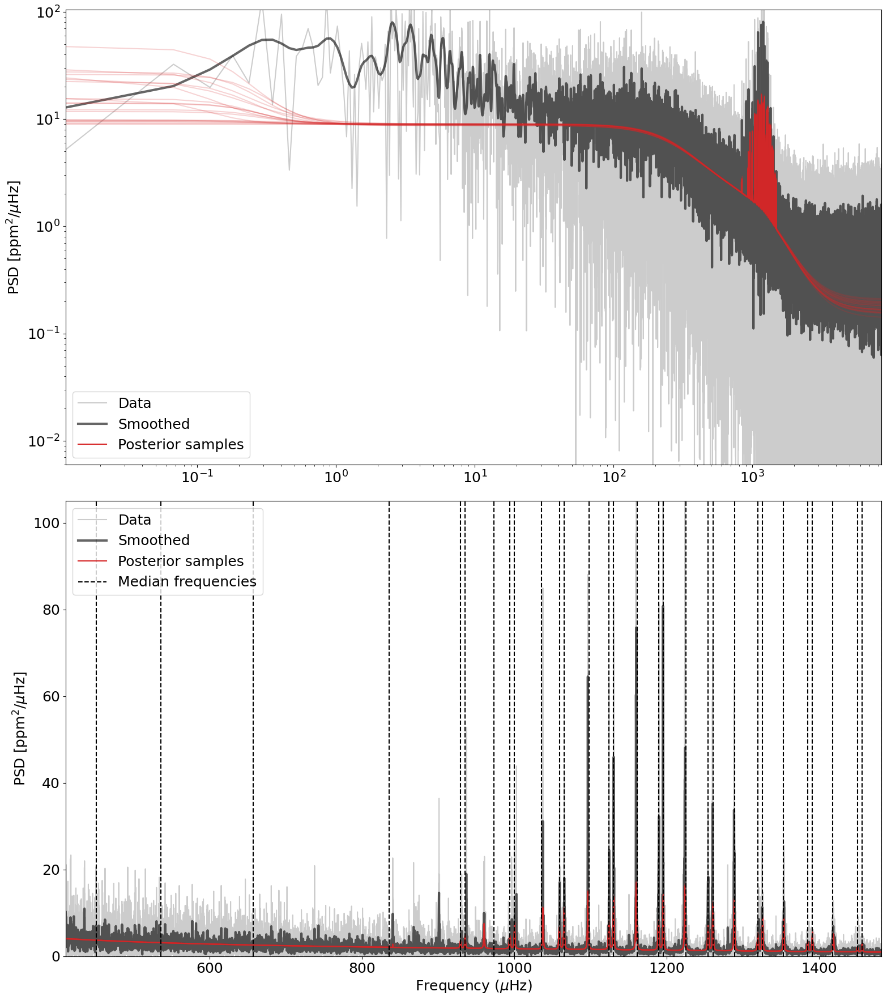

In [9]:
M.spectrum(stage='posterior');

## Corner plot
We can make a nice corner plot too. However, the samples from the priors contain a mix of latent parameters and model parameters, some in log10, others not. To get everything in terms of linear model parameters we'll need to transform the raw samples

In [10]:
M.corner(stage='posterior');

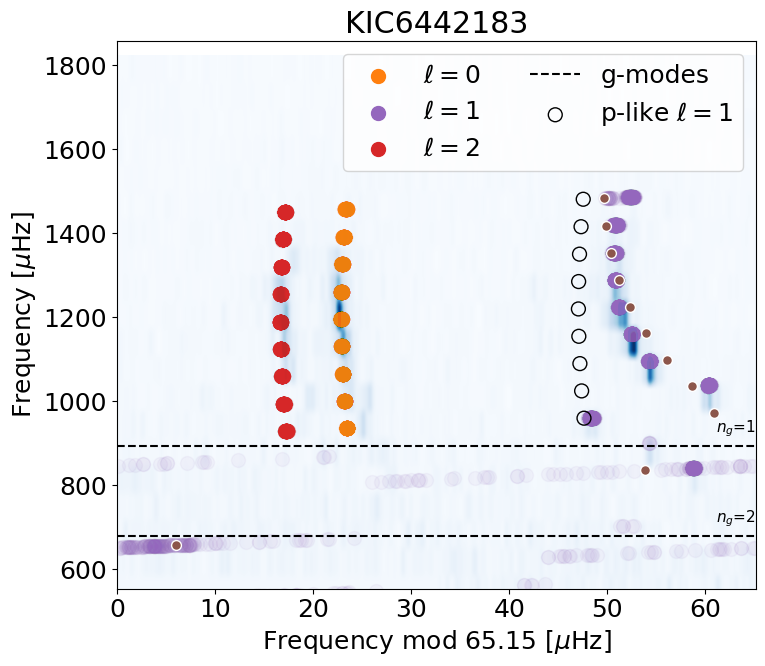

In [11]:
fig, ax = M.echelle(ID=ID);
 
d01 =  M.result['summary']['d01'][0] 
DPi1 =  M.result['summary']['DPi1'][0]
eps_g = M.result['summary']['eps_g'][0]  
alpha_g = M.result['summary']['alpha_g'][0]  
u1 = M.result['summary']['u1'][0] 
u2 = M.result['summary']['u2'][0]   
p_L = jnp.array([(u1 + u2)/jnp.sqrt(2)])  
p_D = jnp.array([(u1 - u2)/jnp.sqrt(2)])  

numax = M.result['summary']['numax'][0]
dnu = M.result['summary']['dnu'][0]  
eps_p = M.result['summary']['eps_p'][0]
alpha_p = M.result['summary']['alpha_p'][0]

nu0_p, n_p = M.AsyFreqModel.asymptotic_nu_p(numax, dnu, eps_p, alpha_p)
nu_g = M.MixFreqModel.asymptotic_nu_g(M.MixFreqModel.n_g, DPi1, eps_g, alpha_g )
nu_m, zeta = M.MixFreqModel.mixed_nu1(nu0_p, n_p, d01, DPi1, p_L, p_D, eps_g, alpha_g)
ax.scatter(nu_m%dnu, nu_m, c='C5', zorder=99, label='Summary stats', s=50, ec='w')

Text(0.5, 0, 'Mode frequency [$\\mu$Hz]')

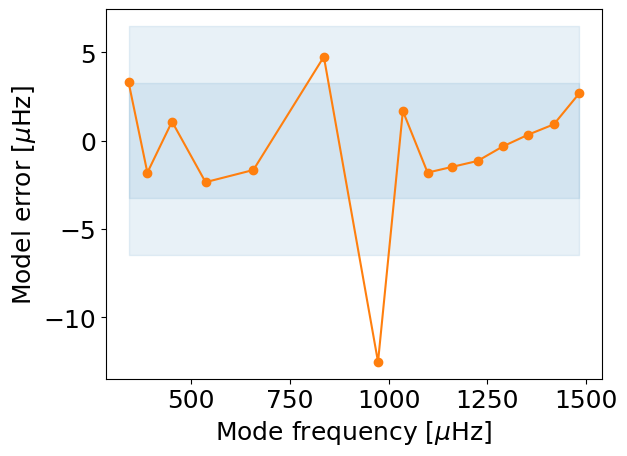

In [30]:
import numpy as np
freqError = np.array([M.result['summary'][key] for key in M.result['summary'].keys() if key.startswith('freqError')]).T
x = M.result['summary']['freq'][0,M.result['ell']==1]

plt.plot(x, freqError[0, :], color='C1')
plt.plot(x, freqError[0, :],'o', color='C1')
plt.fill_between(x, y1=1/20*M.obs['dnu'][0], y2=-1/20*M.obs['dnu'][0], alpha=0.1, color='C0')
plt.fill_between(x, y1=2/20*M.obs['dnu'][0], y2=-2/20*M.obs['dnu'][0], alpha=0.1, color='C0', label='1 & 2 $\sigma$ Prior width')
plt.ylabel('Model error [$\mu$Hz]')
plt.xlabel('Mode frequency [$\mu$Hz]')

In [12]:
import pandas as pd 

_tmp = {key: M.result['summary'][key] for key in M.result['summary'].keys() if key not in ['freq', 'height', 'width']}

df_data = [{'name': key, 'mean': value[0], 'error': value[1]} for key, value in _tmp.items()]

df = pd.DataFrame(df_data)

df

,name,mean,error
0,dnu,65.154762,0.010209
1,numax,1205.336355,1.339030
2,eps_p,1.351272,0.002699
3,d02,6.202340,0.053519
4,alpha_p,0.001017,0.000035
5,env_width,145.349845,0.507293
6,env_height,4.677344,0.069861
7,mode_width,1.066456,0.007815
8,teff,5524.017601,6.848146
9,bp_rp,0.920465,0.002229


In [31]:
from pbjam.peakbagging import peakbag

P = peakbag(M.f, 
            M.s, 
            **M.result, 
            **M.result['summary'],
            freq_limits = [700, 1600])

[1.06645619 1.06645619 1.06645619 1.06645619 1.06645619 1.06645619
 1.06645619 1.06645619 1.06645619 1.00237149 1.01502905 1.02949397
 1.0404834  1.04855924 1.05397399 1.0576193  1.06000464 1.06151851
 1.06645619 1.06645619 1.06645619 1.06645619 1.06645619 1.06645619
 1.06645619 1.06645619 1.06645619]


(<Figure size 1600x900 with 1 Axes>,
 <AxesSubplot: xlabel='Frequency ($\\mu \\rm Hz$)', ylabel='PSD [$\\mathrm{ppm}^2/\\mu \\rm Hz$]'>)

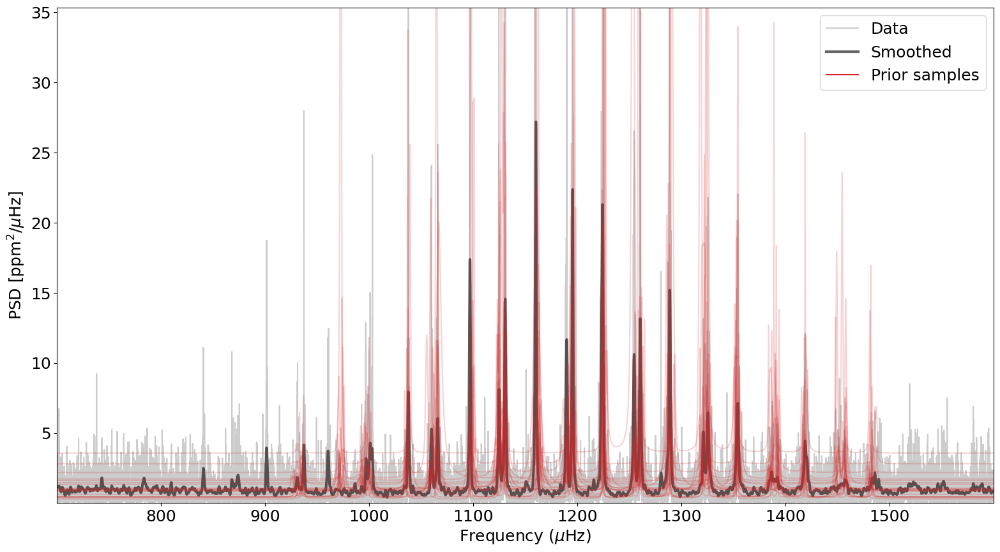

In [32]:
P.spectrum(stage='prior')

In [33]:
pbSamples, pbResult = P(dynesty_kwargs = {'nlive':5*P.ndims, 'sample': 'rwalk'})

5428it [01:37, 43.89it/s, bound: 63 | nc: 105 | ncall: 429261 | eff(%):  1.264 | loglstar:   -inf < -18351.839 <    inf | logz: -18369.016 +/-  0.194 | dlogz: 301.417 >  0.434]Traceback (most recent call last):
  File "/home/nielsemb/.local/lib/python3.10/site-packages/dynesty/dynesty.py", line 910, in __call__
    return self.func(np.asarray(x).copy(), *self.args, **self.kwargs)
KeyboardInterrupt
5432it [01:37, 55.71it/s, bound: 63 | nc: 105 | ncall: 429681 | eff(%):  1.264 | loglstar:   -inf < -18351.410 <    inf | logz: -18368.345 +/-  0.194 | dlogz: 300.695 >  0.434]


Exception while calling loglikelihood function:
  params: [ 9.34618742e+02  1.00058348e+03  1.06495032e+03  1.13074792e+03
  1.19548213e+03  1.26029471e+03  1.32487286e+03  1.38893383e+03
  1.45818374e+03  9.74153798e+02  1.03653073e+03  1.09667866e+03
  1.15977201e+03  1.22529222e+03  1.28942279e+03  1.35641835e+03
  1.42206299e+03  1.48259305e+03  9.29181189e+02  9.92968068e+02
  1.06039963e+03  1.12398590e+03  1.19058915e+03  1.25481889e+03
  1.31958449e+03  1.38652302e+03  1.45367304e+03  4.60304675e-01
  1.12062235e-01  5.86829332e-01  9.38887322e-01  9.87392952e-01
  6.81931852e-01  1.11761419e+00  7.74605226e-01  2.13790206e-01
  6.35651278e-02  1.71167598e-01  6.11738607e-01  1.03638608e+00
  1.48576492e+00  9.45056604e-01  5.39404639e-01  4.00856021e-01
  4.21389907e-02  6.18478579e-01 -2.33157576e-01  1.60490324e-01
  4.31958089e-01  9.68894335e-01  4.71779265e-01  5.83440536e-02
  2.12470862e-01  3.76915715e-01  6.88212531e-02 -6.02798950e-03
 -2.83425306e-01  1.61359577e-01

Traceback (most recent call last):
  File "/home/nielsemb/.local/lib/python3.10/site-packages/IPython/core/interactiveshell.py", line 3433, in run_code
    exec(code_obj, self.user_global_ns, self.user_ns)
  File "/tmp/ipykernel_5449/1983237627.py", line 1, in <module>
    pbSamples, pbResult = P(dynesty_kwargs = {'nlive':5*P.ndims, 'sample': 'rwalk'})
  File "/home/nielsemb/work/repos/PBjam/pbjam/peakbagging.py", line 389, in __call__
  File "/home/nielsemb/work/repos/PBjam/pbjam/peakbagging.py", line 468, in runDynesty
  File "/home/nielsemb/.local/lib/python3.10/site-packages/dynesty/sampler.py", line 1017, in run_nested
    for it, results in enumerate(
  File "/home/nielsemb/.local/lib/python3.10/site-packages/dynesty/sampler.py", line 840, in sample
    u, v, logl, nc = self._new_point(loglstar_new)
  File "/home/nielsemb/.local/lib/python3.10/site-packages/dynesty/sampler.py", line 421, in _new_point
    u, v, logl, nc, blob = self._get_point_value(loglstar)
  File "/home/nielse

In [ ]:
P.spectrum(stage='posterior')

In [ ]:
pbResult

In [ ]:
modeIDresult

In [19]:
import pickle
pickle.dump(modeIDresult, open(f"asymptotic_fit_{ID}.p", "wb" ) )
pickle.dump(pbResult, open(f"peakbag_fit_{ID}.p", "wb" ) )